# **Import thư viện**

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import seaborn as sn
import seaborn as sbn
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans
from sklearn import metrics
from sklearn.cluster import AgglomerativeClustering
import warnings
import sys
if not sys.warnoptions:
    warnings.simplefilter("ignore")
np.random.seed(42)

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
!pip install --upgrade pip

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install pandas_profiling

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 kB 6.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 352.3/352.3 kB 12.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 8.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 kB 22.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 27.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 455.4/455.4 kB 39.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 59.5 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=cd2a3bd27c60a34d1409188c30d4e3148aa7a6a93514d588411459d443547e78
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin
  Attemp

In [ ]:
from pandas_profiling import ProfileReport

<ipython-input-8-e2a33329b6f0>:1: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  from pandas_profiling import ProfileReport


# **Import data**

Nguồn dữ liệu: https://www.kaggle.com/datasets/imakash3011/customer-personality-analysis

In [ ]:
data = pd.read_csv("/content/gdrive/MyDrive/Khoá 3 - Mindx/marketing_campaign.csv",sep="\t")

In [ ]:
df = data.copy()

In [ ]:
df

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,04-09-2012,58,635,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,08-03-2014,38,11,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,21-08-2013,26,426,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,10-02-2014,26,11,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,19-01-2014,94,173,...,5,0,0,0,0,0,0,3,11,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,10870,1967,Graduation,Married,61223.0,0,1,13-06-2013,46,709,...,5,0,0,0,0,0,0,3,11,0
2236,4001,1946,PhD,Together,64014.0,2,1,10-06-2014,56,406,...,7,0,0,0,1,0,0,3,11,0
2237,7270,1981,Graduation,Divorced,56981.0,0,0,25-01-2014,91,908,...,6,0,1,0,0,0,0,3,11,0
2238,8235,1956,Master,Together,69245.0,0,1,24-01-2014,8,428,...,3,0,0,0,0,0,0,3,11,0


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2240 non-null   int64  
 1   Year_Birth           2240 non-null   int64  
 2   Education            2240 non-null   object 
 3   Marital_Status       2240 non-null   object 
 4   Income               2216 non-null   float64
 5   Kidhome              2240 non-null   int64  
 6   Teenhome             2240 non-null   int64  
 7   Dt_Customer          2240 non-null   object 
 8   Recency              2240 non-null   int64  
 9   MntWines             2240 non-null   int64  
 10  MntFruits            2240 non-null   int64  
 11  MntMeatProducts      2240 non-null   int64  
 12  MntFishProducts      2240 non-null   int64  
 13  MntSweetProducts     2240 non-null   int64  
 14  MntGoldProds         2240 non-null   int64  
 15  NumDealsPurchases    2240 non-null   i

In [ ]:
profile = ProfileReport(df)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# **Data processing**

##**Missing value**

In [ ]:
df.isnull().sum()

ID                      0
Year_Birth              0
Education               0
Marital_Status          0
Income                 24
Kidhome                 0
Teenhome                0
Dt_Customer             0
Recency                 0
MntWines                0
MntFruits               0
MntMeatProducts         0
MntFishProducts         0
MntSweetProducts        0
MntGoldProds            0
NumDealsPurchases       0
NumWebPurchases         0
NumCatalogPurchases     0
NumStorePurchases       0
NumWebVisitsMonth       0
AcceptedCmp3            0
AcceptedCmp4            0
AcceptedCmp5            0
AcceptedCmp1            0
AcceptedCmp2            0
Complain                0
Z_CostContact           0
Z_Revenue               0
Response                0
dtype: int64

In [ ]:
df = df.dropna()
print("Số dòng sau khi xoá missing value : ",len(df))

Số dòng sau khi xoá missing value :  2216


## **Duplicated value**

In [ ]:
# In ra dữ liệu bị trùng lập
duplicateRows = df[df.duplicated()]
print('Số dòng dữ liệu duplicates: ', len(duplicateRows))

Số dòng dữ liệu duplicates:  0


## **Feature Engineering**

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2216 entries, 0 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2216 non-null   int64  
 1   Year_Birth           2216 non-null   int64  
 2   Education            2216 non-null   object 
 3   Marital_Status       2216 non-null   object 
 4   Income               2216 non-null   float64
 5   Kidhome              2216 non-null   int64  
 6   Teenhome             2216 non-null   int64  
 7   Dt_Customer          2216 non-null   object 
 8   Recency              2216 non-null   int64  
 9   MntWines             2216 non-null   int64  
 10  MntFruits            2216 non-null   int64  
 11  MntMeatProducts      2216 non-null   int64  
 12  MntFishProducts      2216 non-null   int64  
 13  MntSweetProducts     2216 non-null   int64  
 14  MntGoldProds         2216 non-null   int64  
 15  NumDealsPurchases    2216 non-null   i

###Chuyển DT_Customer thành số ngày khách hàng trở thành khách hàng của công ty

In [ ]:
df['Dt_Customer'] = pd.to_datetime(df['Dt_Customer'])

<ipython-input-10-5ede84e7ffb2>:1: UserWarning: Parsing dates in DD/MM/YYYY format when dayfirst=False (the default) was specified. This may lead to inconsistently parsed dates! Specify a format to ensure consistent parsing.
  df['Dt_Customer'] = pd.to_datetime(df['Dt_Customer'])
<ipython-input-10-5ede84e7ffb2>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Dt_Customer'] = pd.to_datetime(df['Dt_Customer'])


In [ ]:
dates = [i.date() for i in df["Dt_Customer"]]
print("Ngày đăng kí của khách hàng mới nhất với công ty: ", max(dates))
print("Ngày đăng kí của khách hàng cũ nhất với công ty: ", min(dates))

Ngày đăng kí của khách hàng mới nhất với công ty:  2014-12-06
Ngày đăng kí của khách hàng cũ nhất với công ty:  2012-01-08


In [ ]:
# Xét theo định dạng YYYY/DD/MM

In [ ]:
number_of_days = []
d1 = max(dates)
for i in dates:
    delta = d1 - i
    number_of_days.append(delta)
df["Customer_For"] = number_of_days
df["Customer_For"] = pd.to_numeric(df["Customer_For"], errors="raise")

<ipython-input-13-3f321a9bf105>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["Customer_For"] = number_of_days
<ipython-input-13-3f321a9bf105>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["Customer_For"] = pd.to_numeric(df["Customer_For"], errors="raise")


In [ ]:
df.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response,Customer_For
0,5524,1957,Graduation,Single,58138.0,0,0,2012-04-09,58,635,...,0,0,0,0,0,0,3,11,1,83894400000000000
1,2174,1954,Graduation,Single,46344.0,1,1,2014-08-03,38,11,...,0,0,0,0,0,0,3,11,0,10800000000000000
2,4141,1965,Graduation,Together,71613.0,0,0,2013-08-21,26,426,...,0,0,0,0,0,0,3,11,0,40780800000000000
3,6182,1984,Graduation,Together,26646.0,1,0,2014-10-02,26,11,...,0,0,0,0,0,0,3,11,0,5616000000000000
4,5324,1981,PhD,Married,58293.0,1,0,2014-01-19,94,173,...,0,0,0,0,0,0,3,11,0,27734400000000000


###Chuyển Year_Birth thành Age

In [ ]:
# Tính tuổi của khách hàng (tính từ năm 2023) thông qua feature "Year_Birth"
df["Age"] = 2023 - df["Year_Birth"]

<ipython-input-15-62e482c01f83>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["Age"] = 2023 - df["Year_Birth"]


### Tính tổng chi tiêu của khách hàng - "Spent"

In [ ]:
df["Spent"] = df["MntWines"]+ df["MntFruits"]+ df["MntMeatProducts"]+ df["MntFishProducts"] + df["MntSweetProducts"]+ df["MntGoldProds"]

<ipython-input-16-2262ba4d3ebc>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["Spent"] = df["MntWines"]+ df["MntFruits"]+ df["MntMeatProducts"]+ df["MntFishProducts"]+ df["MntSweetProducts"]+ df["MntGoldProds"]


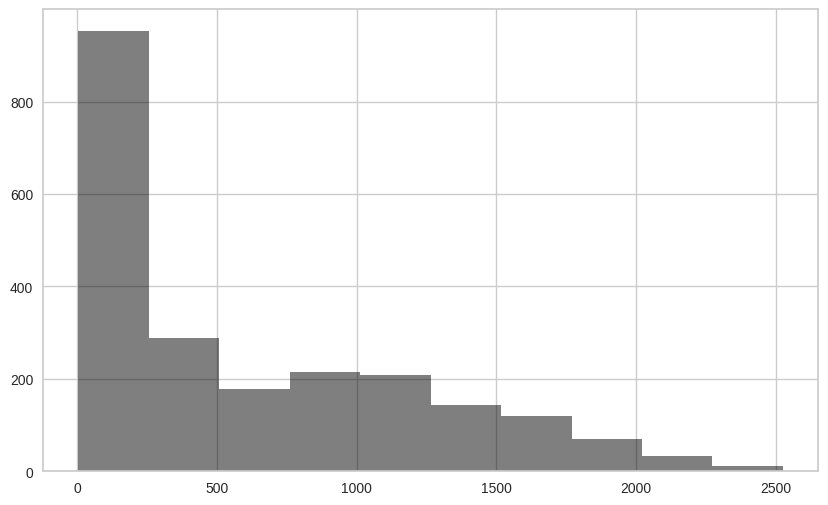

In [ ]:
plt.figure(figsize=(10,6))
df['Spent'].hist(alpha=0.5,color='black')
plt.show()

###Chỉnh sửa biến "Marital_Status"

In [ ]:
df["Marital_Status"].value_counts()

Married     857
Together    573
Single      471
Divorced    232
Widow        76
Alone         3
Absurd        2
YOLO          2
Name: Marital_Status, dtype: int64

In [ ]:
# Chuyển biến "Marital_Status" thành "Living_With" để xem xét tình trạng sống của các khách hàng (Là sống chung với partner hay là một mình)
df["Living_With"]=df["Marital_Status"].replace({"Married":"Partner", "Together":"Partner",
                                                "Absurd":"Alone", "Widow":"Alone", "YOLO":"Alone",
                                                "Divorced":"Alone", "Single":"Alone",})

<ipython-input-19-1ce83dc931e9>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["Living_With"]=df["Marital_Status"].replace({"Married":"Partner", "Together":"Partner", "Absurd":"Alone", "Widow":"Alone", "YOLO":"Alone", "Divorced":"Alone", "Single":"Alone",})


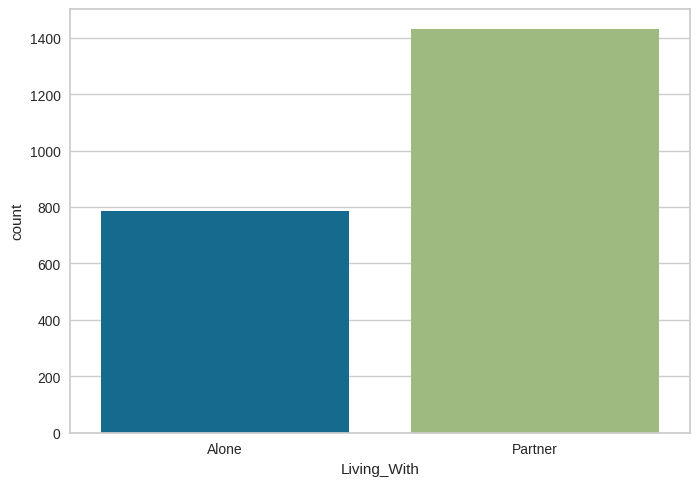

In [ ]:
sns.countplot( x = 'Living_With',data = df)
plt.show()

###Tính tổng số trẻ trong gia đình khách hàng

In [ ]:
df["Children"]=df["Kidhome"]+df["Teenhome"]

<ipython-input-21-8f36236b8ca9>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["Children"]=df["Kidhome"]+df["Teenhome"]


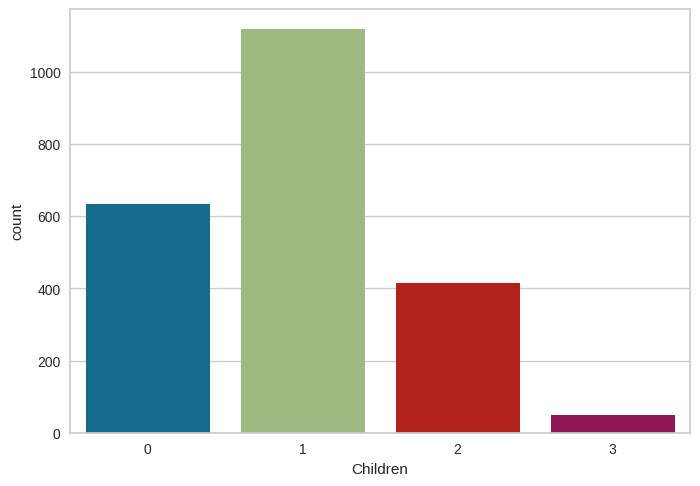

In [ ]:
sns.countplot(x = 'Children' , data = df)
plt.show()

###Phân chia education

#### 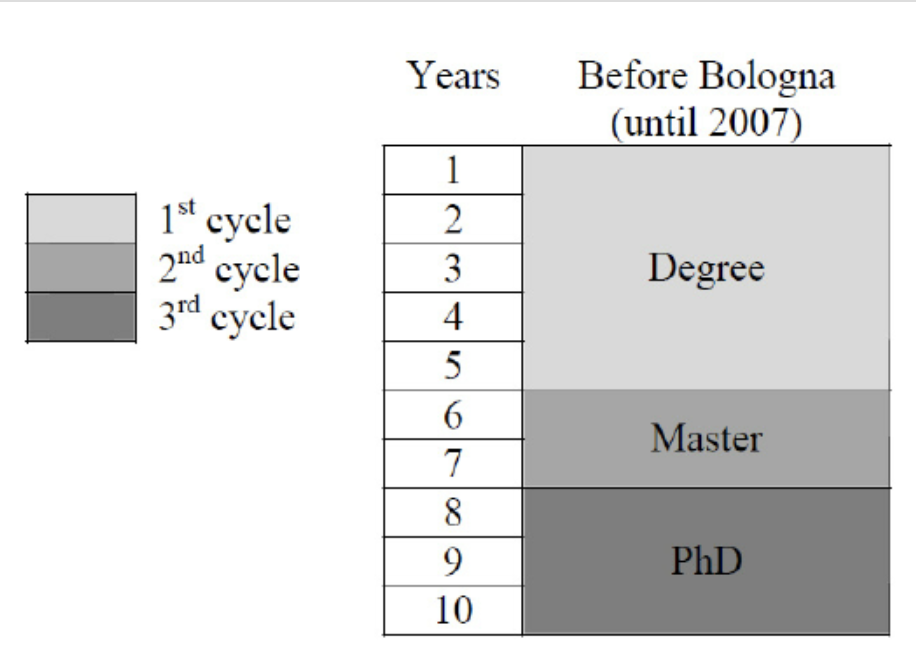

In [ ]:
df["Education"].value_counts()

Graduation    1116
PhD            481
Master         365
2n Cycle       200
Basic           54
Name: Education, dtype: int64

In [ ]:
df["Education"]=df["Education"].replace({"Basic":"Undergraduate", "Graduation":"Graduate",
                                         "Master":"Postgraduate","2n Cycle":"Postgraduate", "PhD":"Postgraduate"})

<ipython-input-24-0c2ec4f8728b>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["Education"]=df["Education"].replace({"Basic":"Undergraduate", "Graduation":"Graduate", "Master":"Postgraduate","2n Cycle":"Postgraduate", "PhD":"Postgraduate"})


In [ ]:
df['Education'].value_counts()

Graduate         1116
Postgraduate     1046
Undergraduate      54
Name: Education, dtype: int64

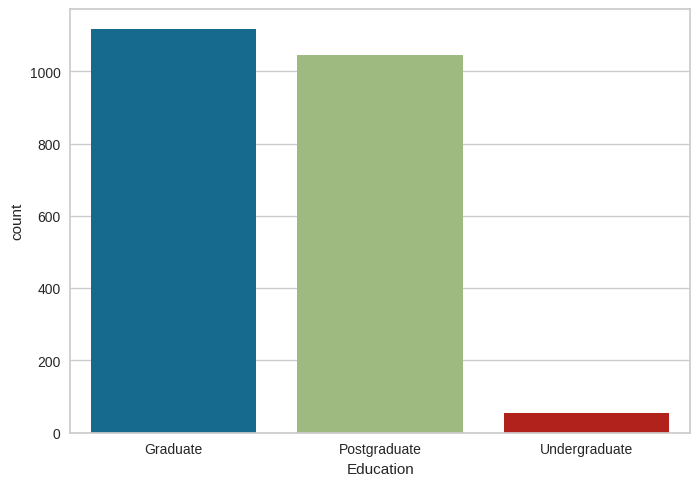

In [ ]:
sns.countplot(x = 'Education' , data = df)
plt.show()

###Đổi tên các biến feauture sản phẩm

In [ ]:
df = df.rename(columns={"MntWines": "Wines",
                            "MntFruits": "Fruits",
                            "MntFishProducts": "Fish",
                            "MntSweetProducts": "Sweets",
                            "MntGoldProds": "Gold",
                            "MntMeatProducts":"Meat"})

### Tính tổng lượt mua của khách hàng

In [ ]:
df['NumTotalPurchases'] = df['NumWebPurchases'] + df['NumCatalogPurchases'] + df['NumStorePurchases']

In [ ]:
df['NumTotalPurchases'].unique()

array([22,  4, 20,  6, 14, 17,  8,  5,  1, 15, 12, 25, 11, 24, 28, 13, 10,
        7, 23, 19,  3, 16, 26, 18, 31,  9, 27, 21, 32, 29, 30,  0,  2])

###Drop các cột không cần thiết

In [ ]:
df = df.drop(["Marital_Status", "Dt_Customer", "Z_CostContact", "Z_Revenue",
           "Year_Birth", "ID", "Kidhome","Teenhome"], axis=1)

In [ ]:
df

,Education,Income,Recency,Wines,Fruits,Meat,Fish,Sweets,Gold,NumDealsPurchases,...,AcceptedCmp1,AcceptedCmp2,Complain,Response,Customer_For,Age,Spent,Living_With,Children,NumTotalPurchases
0,Graduate,58138.0,58,635,88,546,172,88,88,3,...,0,0,0,1,83894400000000000,66,1617,Alone,0,22
1,Graduate,46344.0,38,11,1,6,2,1,6,2,...,0,0,0,0,10800000000000000,69,27,Alone,2,4
2,Graduate,71613.0,26,426,49,127,111,21,42,1,...,0,0,0,0,40780800000000000,58,776,Partner,0,20
3,Graduate,26646.0,26,11,4,20,10,3,5,2,...,0,0,0,0,5616000000000000,39,53,Partner,1,6
4,Postgraduate,58293.0,94,173,43,118,46,27,15,5,...,0,0,0,0,27734400000000000,42,422,Partner,1,14
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,Graduate,61223.0,46,709,43,182,42,118,247,2,...,0,0,0,0,46742400000000000,56,1341,Partner,1,16
2236,Postgraduate,64014.0,56,406,0,30,0,0,8,7,...,1,0,0,0,5270400000000000,77,444,Partner,3,15
2237,Graduate,56981.0,91,908,48,217,32,12,24,1,...,0,0,0,0,27216000000000000,42,1241,Alone,0,18
2238,Postgraduate,69245.0,8,428,30,214,80,30,61,2,...,0,0,0,0,27302400000000000,67,843,Partner,1,21


In [ ]:
#Số dòng / Số cột sau khi drop
len_df=df.shape[0]
print("Số dòng m mới = ",len_df )
print("Số cột n mới = ", df.shape[1])

Số dòng m mới =  2216
Số cột n mới =  27


## **Xử lý Outlier**

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2216 entries, 0 to 2239
Data columns (total 27 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Education            2216 non-null   object 
 1   Income               2216 non-null   float64
 2   Recency              2216 non-null   int64  
 3   Wines                2216 non-null   int64  
 4   Fruits               2216 non-null   int64  
 5   Meat                 2216 non-null   int64  
 6   Fish                 2216 non-null   int64  
 7   Sweets               2216 non-null   int64  
 8   Gold                 2216 non-null   int64  
 9   NumDealsPurchases    2216 non-null   int64  
 10  NumWebPurchases      2216 non-null   int64  
 11  NumCatalogPurchases  2216 non-null   int64  
 12  NumStorePurchases    2216 non-null   int64  
 13  NumWebVisitsMonth    2216 non-null   int64  
 14  AcceptedCmp3         2216 non-null   int64  
 15  AcceptedCmp4         2216 non-null   i

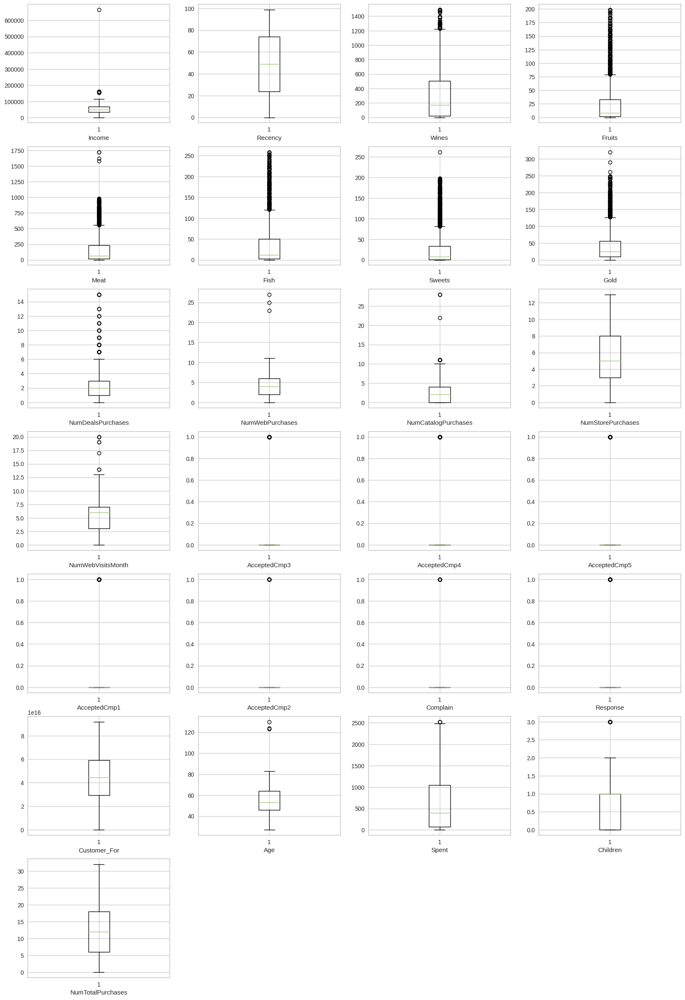

In [ ]:
num_coln = df.select_dtypes(include=np.number).columns.tolist()
bins=10
j=1
fig = plt.figure(figsize = (20, 30))
for i in num_coln:
    plt.subplot(7,4,j)
    plt.boxplot(df[i])
    j=j+1
    plt.xlabel(i)
plt.show()

In [ ]:
'''
- Độ tuổi "Age" với thu nhập "Income" đang có outlier. Ta sẽ xóa các oulier của 2 features này.
Lí do xoá 2 features trên:
+ Thứ 1 age tính có tuổi trên 100 quá nhiều do dữ liệu khách hàng thu nhập đc khá cũ.
+ Thứ 2 income khách hàng ko đồng đều và khoảng cách khá lớn.
- Đối với các cột khác/ features khác , ta không thể loại bỏ một cách mù quáng các ngoại lệ này vì có thể có trường hợp người dùng yêu cầu cao đối với các sản phẩm này. Có thể người tiêu dùng đang tổ chức một bữa tiệc hoặc sự kiện.
'''

'\n- Độ tuổi "Age" với thu nhập "Income" đang có outlier. Ta sẽ xóa các oulier của 2 features này.\nLí do xoá 2 features trên:\n+ Thứ 1 age tính có tuổi trên 100 quá nhiều do dữ liệu khách hàng thu nhập đc khá cũ.\n+ Thứ 2 income khách hàng ko đồng đều và khoảng cách khá lớn.\n- Đối với các cột khác/ features khác , ta không thể loại bỏ một cách mù quáng các ngoại lệ này vì có thể có trường hợp người dùng yêu cầu cao đối với các sản phẩm này. Có thể người tiêu dùng đang tổ chức một bữa tiệc hoặc sự kiện.\n'

In [ ]:
# Đầu tiên ta sẽ kiểm tra oulier của Age
Q1 = np.percentile(df['Age'] , 25)
Q3 = np.percentile(df['Age'] , 75)
IQR = Q3 - Q1
upper = Q3+1.5*IQR
lower = Q1-1.5*IQR
outliers_upper = df['Age'][(df['Age'] > upper)]
outliers_lower = df['Age'][(df['Age'] < lower)]
print('Số lượng outliers cận trên:',len(outliers_upper))
print('Số lượng outliers cận dưới:',len(outliers_lower))

Số lượng outliers cận trên: 3
Số lượng outliers cận dưới: 0


In [ ]:
#Loại bỏ outlier của "Age"
df = df[(df['Age'] >= lower) & (df['Age'] <= upper)]

In [ ]:
# Tiếp theo ta sẽ kiểm tra oulier của Income
Q1 = np.percentile(df['Income'] , 25)
Q3 = np.percentile(df['Income'] , 75)
IQR = Q3 - Q1
upper = Q3+1.5*IQR
lower = Q1-1.5*IQR
outliers_upper = df['Income'][(df['Income'] > upper)]
outliers_lower = df['Income'][(df['Income'] < lower)]
print('Số lượng outliers cận trên:',len(outliers_upper))
print('Số lượng outliers cận dưới:',len(outliers_lower))

Số lượng outliers cận trên: 8
Số lượng outliers cận dưới: 0


In [ ]:
#Loại bỏ outlier của "Income"
df = df[(df['Income'] >= lower) & (df['Income'] <= upper)]

In [ ]:
#Kiểm tra sau khi loại bỏ outlier :
print("Số dòng m cũ  = ", len_df)
print("Số dòng m mới = ", df.shape[0])
print("Chênh lệch    =",len_df-df.shape[0])
print("Số cột n mới  = ", df.shape[1])

Số dòng m cũ  =  2216
Số dòng m mới =  2205
Chênh lệch    = 11
Số cột n mới  =  27


In [ ]:
df1 = df.copy()

# **EDA**

### Heatmap

<ipython-input-490-6f9b34ade361>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(df1.corr(), annot=True)


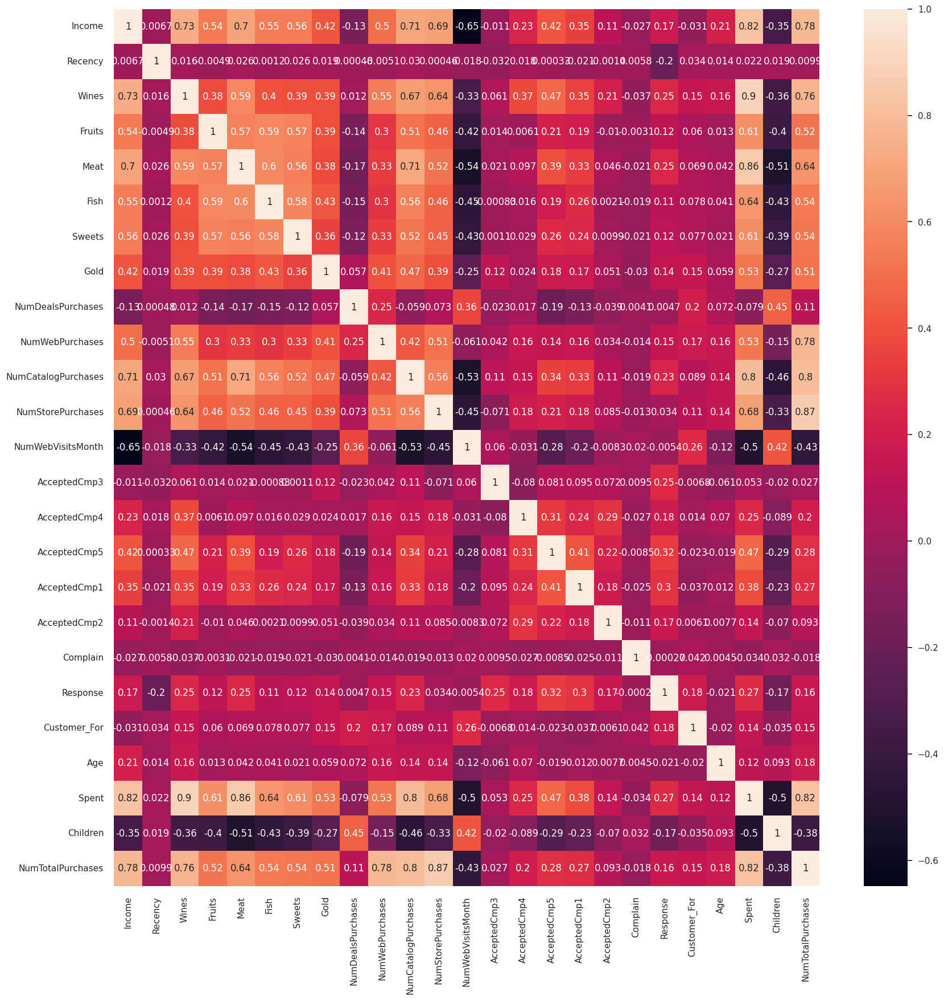

In [ ]:
plt.figure(figsize=(20,20))
sns.heatmap(df1.corr(), annot=True)
plt.show()

### Thể hiện phân phối

####People

<ipython-input-491-c3d8812bbccf>:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df1["Income"],color = 'black')


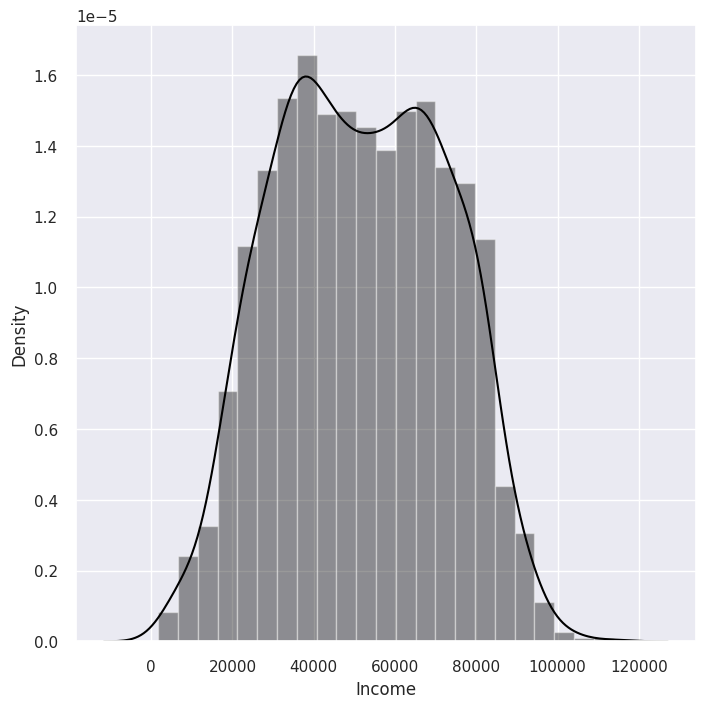

In [ ]:
plt.figure(figsize=(8,8))
sns.distplot(df1["Income"],color = 'black')
plt.show()

<ipython-input-492-5b859a10b6db>:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df1["Recency"],color = 'black')


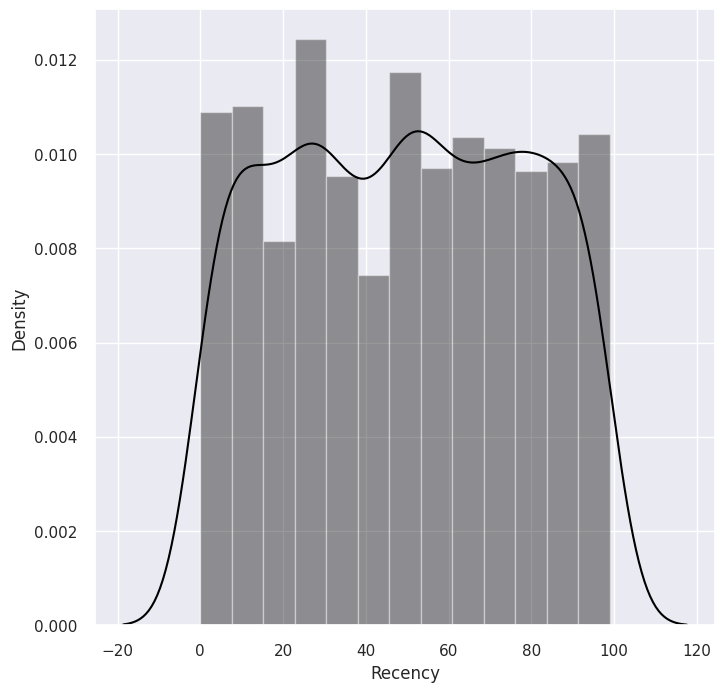

In [ ]:
plt.figure(figsize=(8,8))
sns.distplot(df1["Recency"],color = 'black')
plt.show()

In [ ]:
s = (df.dtypes == 'object')
object_cols = list(s[s].index)

print("Categorical variables in the dataset:", object_cols)

Categorical variables in the dataset: ['Education', 'Living_With']


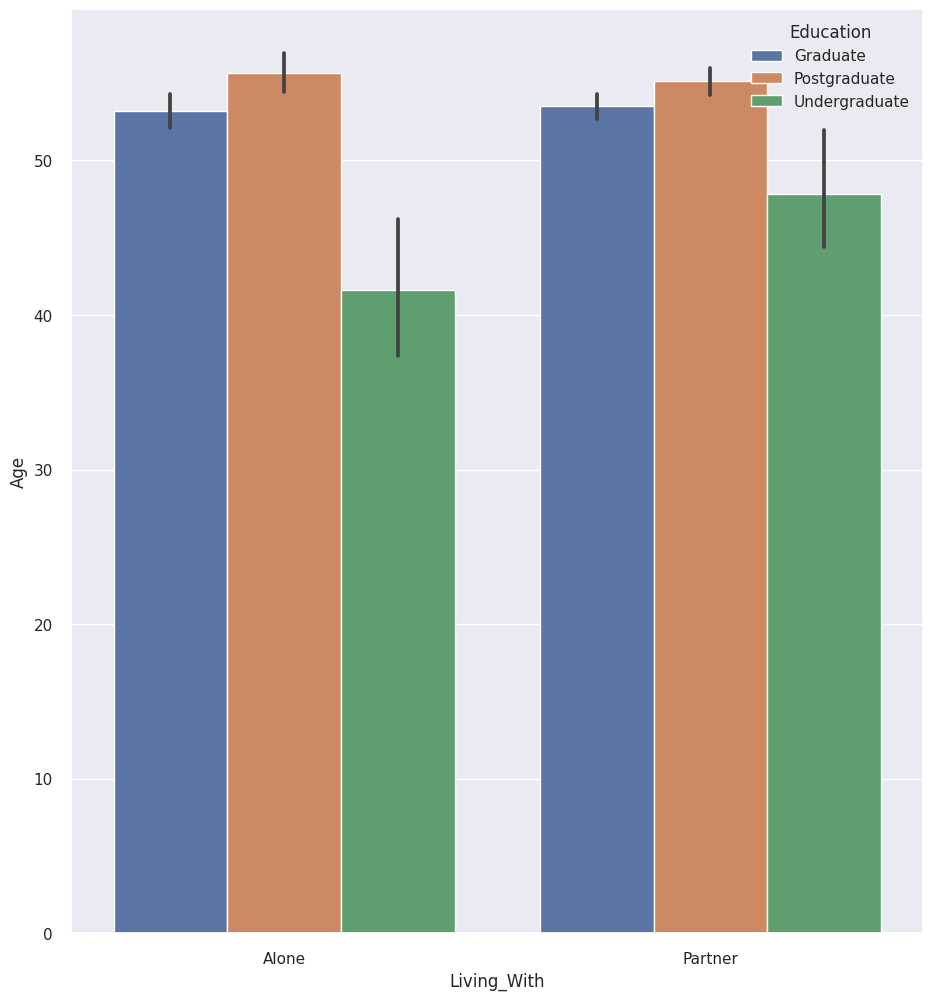

In [ ]:
for i in range(len(object_cols)):
    x='Living_With'
    for j in range(1):
        if object_cols[i] != x:
            sns.barplot(x= x,y='Age',hue=object_cols[i],data=df1)
            sns.set(rc={'figure.figsize':(11,12)})
            plt.show()

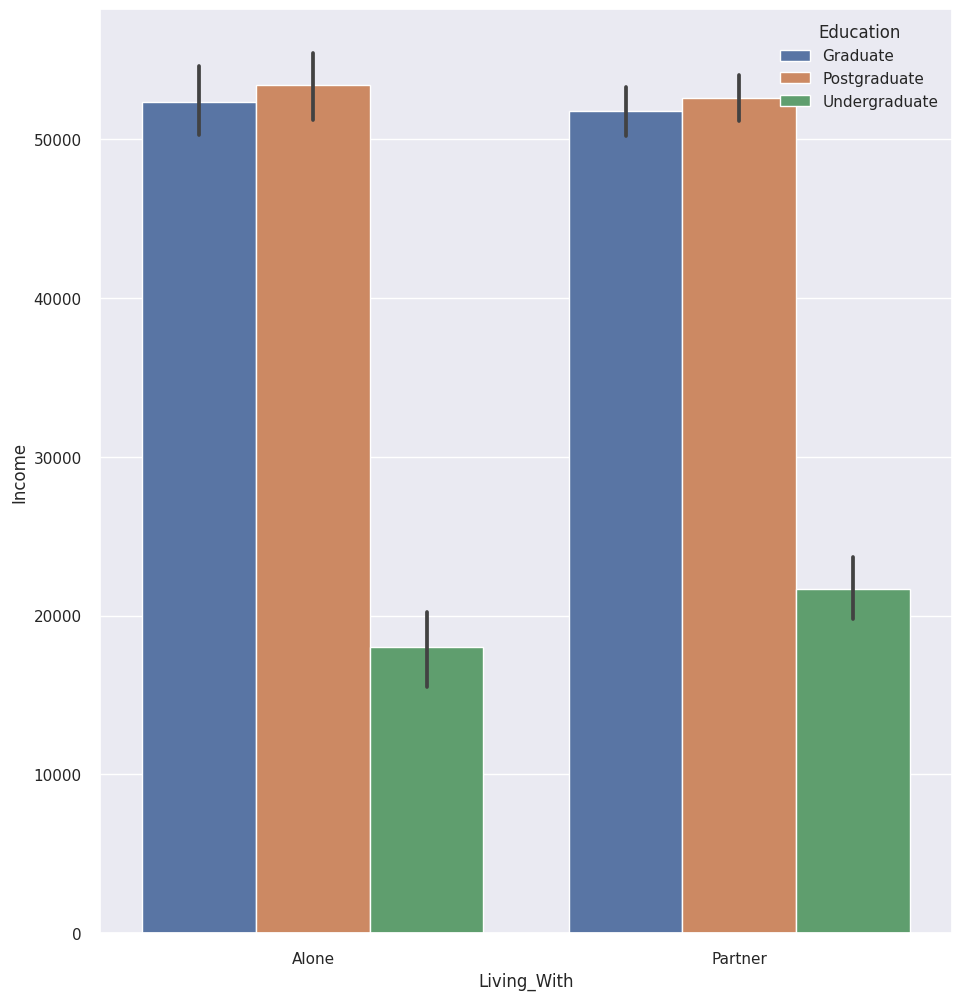

In [ ]:
for i in range(len(object_cols)):
    x='Living_With'
    for j in range(1):
        if object_cols[i] != x:
            sns.barplot(x= x,y='Income',hue=object_cols[i],data=df1)
            sns.set(rc={'figure.figsize':(11,12)})
            plt.show()

####Product

Text(0.5, 1.0, 'Phân phối sản phẩm')

/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning: Glyph 7889 (\N{LATIN SMALL LETTER O WITH CIRCUMFLEX AND ACUTE}) missing from current font.
  func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning: Glyph 7843 (\N{LATIN SMALL LETTER A WITH HOOK ABOVE}) missing from current font.
  func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning: Glyph 7849 (\N{LATIN SMALL LETTER A WITH CIRCUMFLEX AND HOOK ABOVE}) missing from current font.
  func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 7889 (\N{LATIN SMALL LETTER O WITH CIRCUMFLEX AND ACUTE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 7843 (\N{LATIN SMALL LETTER A WITH HOOK ABOVE}) missing from current font.
  fig.canvas.print_figure(bytes_io, 

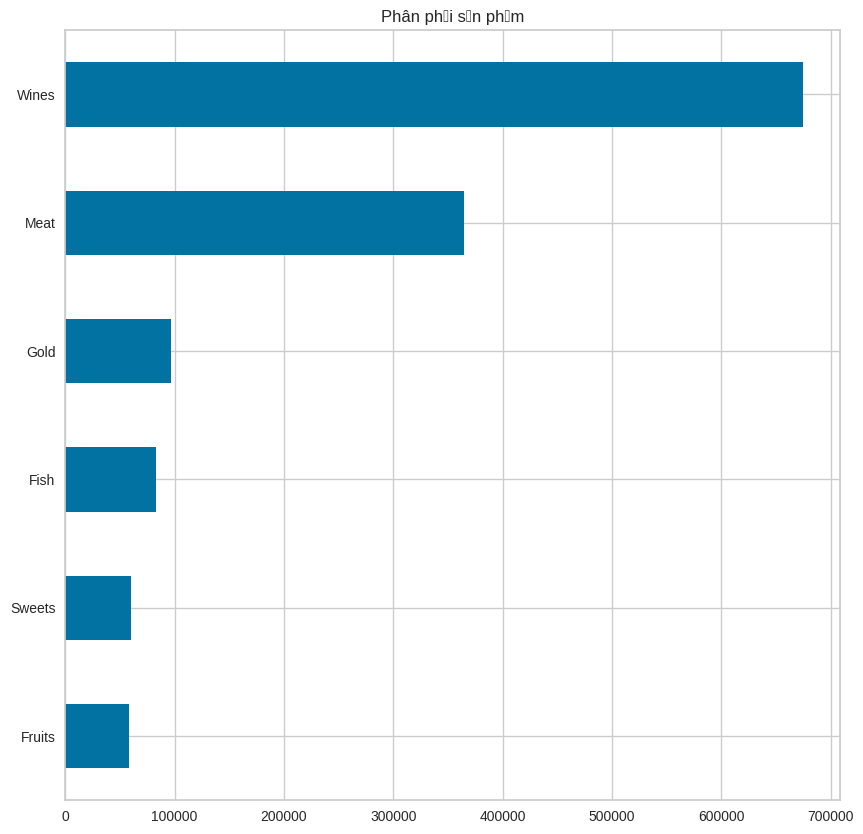

In [ ]:
plt.figure(figsize = (10,10))
ax = df[['Meat','Gold','Sweets','Wines','Fish','Fruits']].sum().sort_values(ascending = True).plot(kind = 'barh')
plt.title('Phân phối sản phẩm')

####Promotion

In [ ]:
df['TotalAcceptedCmp'] = df['AcceptedCmp1'] + df['AcceptedCmp2'] + df['AcceptedCmp3'] + df['AcceptedCmp4'] + df['AcceptedCmp5']

In [ ]:
df['TotalAcceptedCmp'].value_counts()

0    1747
1     322
2      81
3      44
4      11
Name: TotalAcceptedCmp, dtype: int64

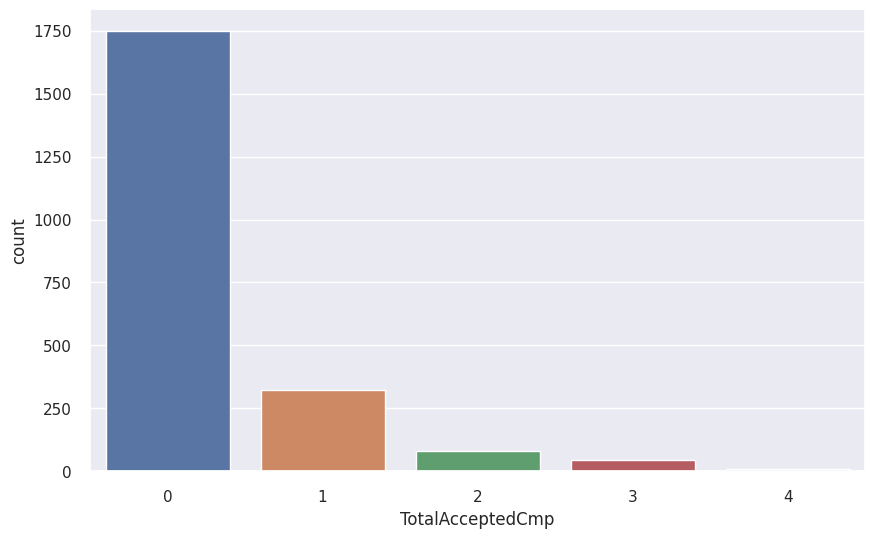

In [ ]:
plt.figure(figsize=(10,6))
sns.countplot(x = 'TotalAcceptedCmp' ,data = df)
plt.show()

Text(0.5, 1.0, 'Phân phối chiến dịch mua hàng')

/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning: Glyph 7889 (\N{LATIN SMALL LETTER O WITH CIRCUMFLEX AND ACUTE}) missing from current font.
  func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning: Glyph 7871 (\N{LATIN SMALL LETTER E WITH CIRCUMFLEX AND ACUTE}) missing from current font.
  func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning: Glyph 7883 (\N{LATIN SMALL LETTER I WITH DOT BELOW}) missing from current font.
  func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 7889 (\N{LATIN SMALL LETTER O WITH CIRCUMFLEX AND ACUTE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 7871 (\N{LATIN SMALL LETTER E WITH CIRCUMFLEX AND ACUTE}) missing from current font.
  fig.canvas.print_figure(bytes_

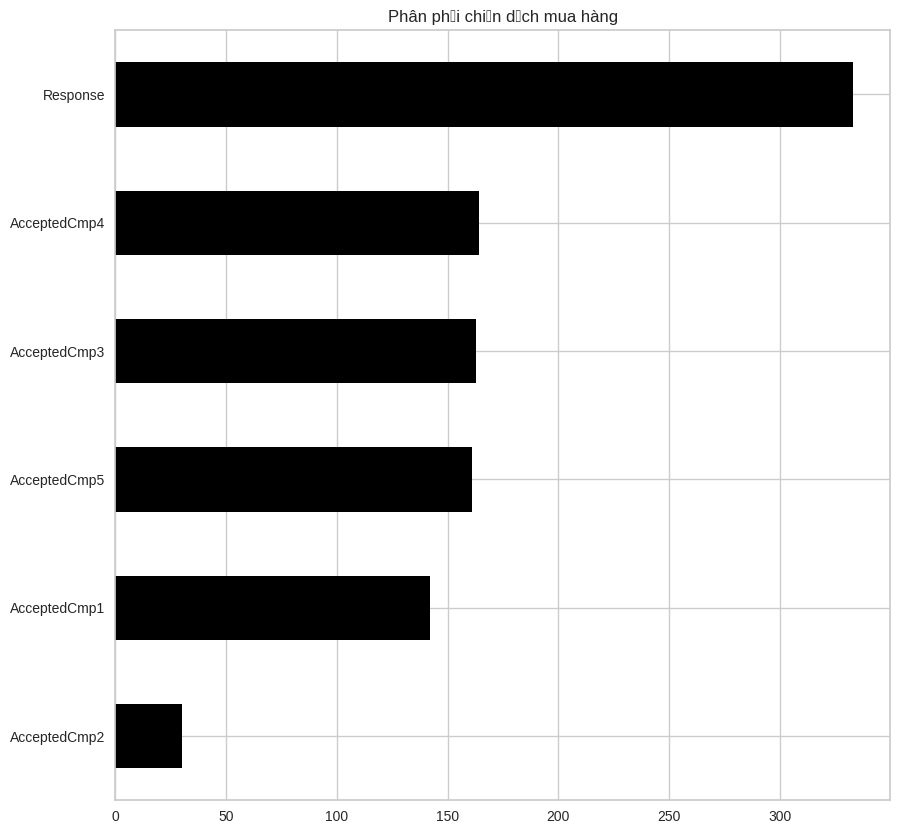

In [ ]:
plt.figure(figsize = (10,10))
ax = df[['AcceptedCmp1','AcceptedCmp2','AcceptedCmp3','AcceptedCmp4','AcceptedCmp5','Response']].sum().sort_values(ascending = True).plot(kind = 'barh',color='black')
plt.title('Phân phối chiến dịch mua hàng')

####Place

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2205 entries, 0 to 2239
Data columns (total 27 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Education            2205 non-null   object 
 1   Income               2205 non-null   float64
 2   Recency              2205 non-null   int64  
 3   Wines                2205 non-null   int64  
 4   Fruits               2205 non-null   int64  
 5   Meat                 2205 non-null   int64  
 6   Fish                 2205 non-null   int64  
 7   Sweets               2205 non-null   int64  
 8   Gold                 2205 non-null   int64  
 9   NumDealsPurchases    2205 non-null   int64  
 10  NumWebPurchases      2205 non-null   int64  
 11  NumCatalogPurchases  2205 non-null   int64  
 12  NumStorePurchases    2205 non-null   int64  
 13  NumWebVisitsMonth    2205 non-null   int64  
 14  AcceptedCmp3         2205 non-null   int64  
 15  AcceptedCmp4         2205 non-null   i

Text(0.5, 1.0, 'Phân phối chỗ mua hàng của khách hàng')

/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning: Glyph 7889 (\N{LATIN SMALL LETTER O WITH CIRCUMFLEX AND ACUTE}) missing from current font.
  func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning: Glyph 7895 (\N{LATIN SMALL LETTER O WITH CIRCUMFLEX AND TILDE}) missing from current font.
  func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning: Glyph 7911 (\N{LATIN SMALL LETTER U WITH HOOK ABOVE}) missing from current font.
  func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 7889 (\N{LATIN SMALL LETTER O WITH CIRCUMFLEX AND ACUTE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 7895 (\N{LATIN SMALL LETTER O WITH CIRCUMFLEX AND TILDE}) missing from current font.
  fig.canvas.print_figure(bytes

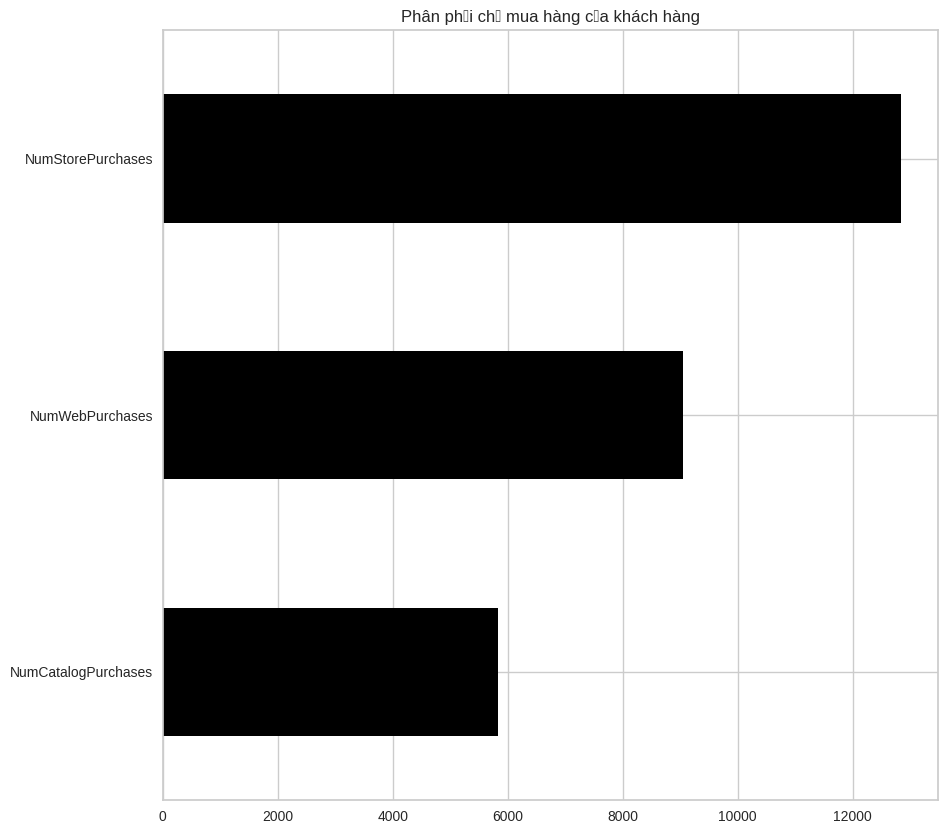

In [ ]:
plt.figure(figsize = (10,10))
ax = df[['NumWebPurchases','NumCatalogPurchases','NumStorePurchases']].sum().sort_values(ascending = True).plot(kind = 'barh',color='black')
plt.title('Phân phối chỗ mua hàng của khách hàng')

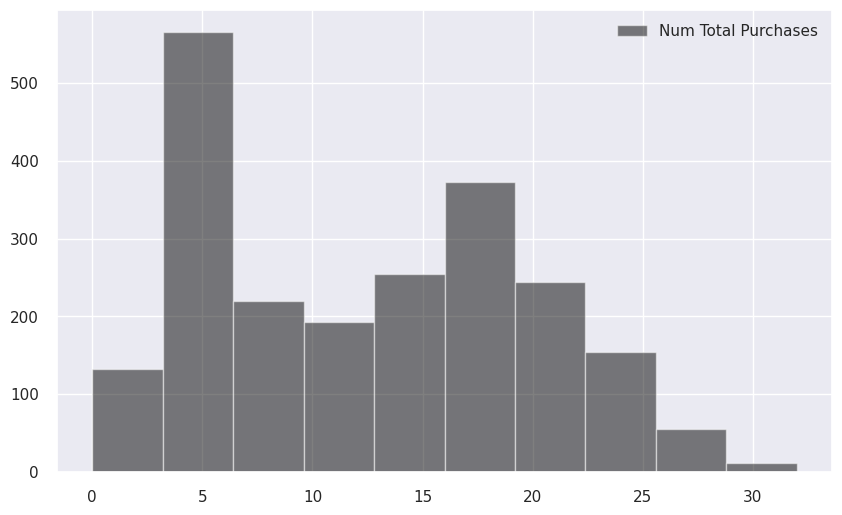

In [ ]:
plt.figure(figsize=(10,6))
df1['NumTotalPurchases'].hist(alpha=0.5,color='black',label='Num Total Purchases')
plt.legend()
plt.show()

### Thể hiện tỉ lệ

Text(0.5, 1.0, '% Response')

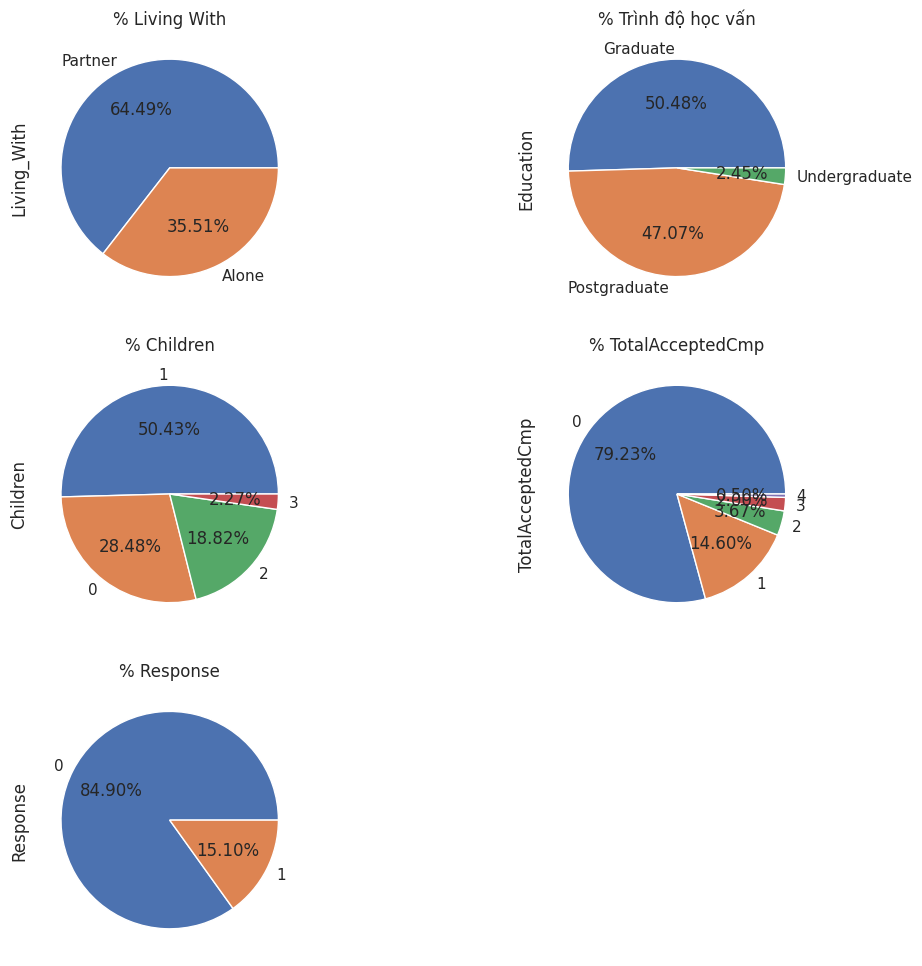

In [ ]:
plt.subplot(3, 2, 1)
ax2 = df1['Living_With'].value_counts().plot(kind = 'pie',figsize=(12,12),autopct='%1.2f%%')
ax2.set_title('% Living With', fontsize = 12)

plt.subplot(3, 2, 2)
ax3 = df1['Education'].value_counts().plot(kind = 'pie',figsize=(12,12),autopct='%1.2f%%')
ax3.set_title('% Trình độ học vấn', fontsize = 12)

plt.subplot(3, 2, 3)
ax4 = df1['Children'].value_counts().plot(kind = 'pie',figsize=(12,12),autopct='%1.2f%%')
ax4.set_title('% Children', fontsize = 12)

plt.subplot(3, 2, 4)
ax6 = df['TotalAcceptedCmp'].value_counts().plot(kind = 'pie',figsize=(12,12),autopct='%1.2f%%')
ax6.set_title('% TotalAcceptedCmp', fontsize = 12)

plt.subplot(3, 2, 5)
ax7 = df1['Response'].value_counts().plot(kind = 'pie',figsize=(12,12),autopct='%1.2f%%')
ax7.set_title('% Response', fontsize = 12)

In [ ]:
# Living With: Partner = 64.49%, Alone = 35.51 %
# Education: Graduate = 50.48%, Undergraduate = 2.45%
# Childrent: 0 = 28.48%, 1 = 50.43%, 2 = 18.82%; 3 = 2.27%
# Total Accepted CMP: 0 = 79.23% ; 1 = 14.60% ; 2 = 3.67% ; 3 = 2.00% ; 4 = 0.50%
# Response: 0 = 84.90% ; 1 = 15.10%

#**Data Scale**

In [ ]:
object_cols

['Education', 'Living_With']

In [ ]:
LE=LabelEncoder()
for i in object_cols:
    df[i]=df[[i]].apply(LE.fit_transform)

In [ ]:
ds = df.copy()

In [ ]:
ds.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2205 entries, 0 to 2239
Data columns (total 28 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Education            2205 non-null   int64  
 1   Income               2205 non-null   float64
 2   Recency              2205 non-null   int64  
 3   Wines                2205 non-null   int64  
 4   Fruits               2205 non-null   int64  
 5   Meat                 2205 non-null   int64  
 6   Fish                 2205 non-null   int64  
 7   Sweets               2205 non-null   int64  
 8   Gold                 2205 non-null   int64  
 9   NumDealsPurchases    2205 non-null   int64  
 10  NumWebPurchases      2205 non-null   int64  
 11  NumCatalogPurchases  2205 non-null   int64  
 12  NumStorePurchases    2205 non-null   int64  
 13  NumWebVisitsMonth    2205 non-null   int64  
 14  AcceptedCmp3         2205 non-null   int64  
 15  AcceptedCmp4         2205 non-null   i

In [ ]:
# Phân khúc khách hàng sẽ dựa trên đặc tính của khách hàng "People" nên chúng ta sẽ loại bỏ các feature liên quan tới Promotion
cols_del = ['AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
            'AcceptedCmp2', 'Complain', 'Response','TotalAcceptedCmp']
ds = ds.drop(cols_del, axis=1)
#Scaling
scaler = StandardScaler()
scaler.fit(ds)
scaled_ds = pd.DataFrame(scaler.transform(ds),columns= ds.columns )

In [ ]:
scaled_ds.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2205 entries, 0 to 2204
Data columns (total 20 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Education            2205 non-null   float64
 1   Income               2205 non-null   float64
 2   Recency              2205 non-null   float64
 3   Wines                2205 non-null   float64
 4   Fruits               2205 non-null   float64
 5   Meat                 2205 non-null   float64
 6   Fish                 2205 non-null   float64
 7   Sweets               2205 non-null   float64
 8   Gold                 2205 non-null   float64
 9   NumDealsPurchases    2205 non-null   float64
 10  NumWebPurchases      2205 non-null   float64
 11  NumCatalogPurchases  2205 non-null   float64
 12  NumStorePurchases    2205 non-null   float64
 13  NumWebVisitsMonth    2205 non-null   float64
 14  Customer_For         2205 non-null   float64
 15  Age                  2205 non-null   f

In [ ]:
scaled_ds.head()

,Education,Income,Recency,Wines,Fruits,Meat,Fish,Sweets,Gold,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Customer_For,Age,Spent,Living_With,Children,NumTotalPurchases
0,-0.951126,0.314651,0.310830,0.974566,1.548614,1.748400,2.449154,1.480301,0.849556,0.361479,1.424772,2.628526,-0.562650,0.689203,1.974128,1.017189,1.679323,-1.347625,-1.266589,1.313658
1,-0.951126,-0.254877,-0.380600,-0.874776,-0.638664,-0.731678,-0.652345,-0.635399,-0.735767,-0.168834,-1.132957,-0.588043,-1.179732,-0.139645,-1.664957,1.273530,-0.963897,-1.347625,1.403420,-1.193752
2,-0.951126,0.965354,-0.795458,0.355155,0.568110,-0.175957,1.336263,-0.149031,-0.039771,-0.699147,1.424772,-0.230646,1.288596,-0.554069,-0.172330,0.333612,0.281242,0.742046,-1.266589,1.035057
3,-0.951126,-1.206087,-0.795458,-0.874776,-0.563241,-0.667380,-0.506392,-0.586763,-0.755100,-0.168834,-0.767567,-0.945440,-0.562650,0.274779,-1.923048,-1.289883,-0.920675,0.742046,0.068415,-0.915151
4,0.878920,0.322136,1.555404,-0.394659,0.417263,-0.217292,0.150396,-0.003121,-0.561768,1.422105,0.328602,0.126750,0.054432,-0.139645,-0.821859,-1.033542,-0.307248,0.742046,0.068415,0.199254


# **PCA**

In [ ]:
pca = PCA(n_components=3)
pca.fit(scaled_ds)
PCA_ds = pd.DataFrame(pca.transform(scaled_ds), columns=(["col1","col2", "col3"]))

In [ ]:
x =PCA_ds["col1"]
y =PCA_ds["col2"]
z =PCA_ds["col3"]

In [ ]:
PCA_ds.describe().T

,count,mean,std,min,25%,50%,75%,max
col1,2205.0,3.222416e-17,2.828348,-5.652919,-2.656051,-0.694908,2.467191,7.603154
col2,2205.0,1.288966e-17,1.415668,-3.220788,-1.005397,-0.249458,0.849176,5.971516
col3,2205.0,5.316986e-17,1.124018,-3.330732,-0.767883,-0.028858,0.744465,4.692863


# **CLUSTERING: KMEAN**

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

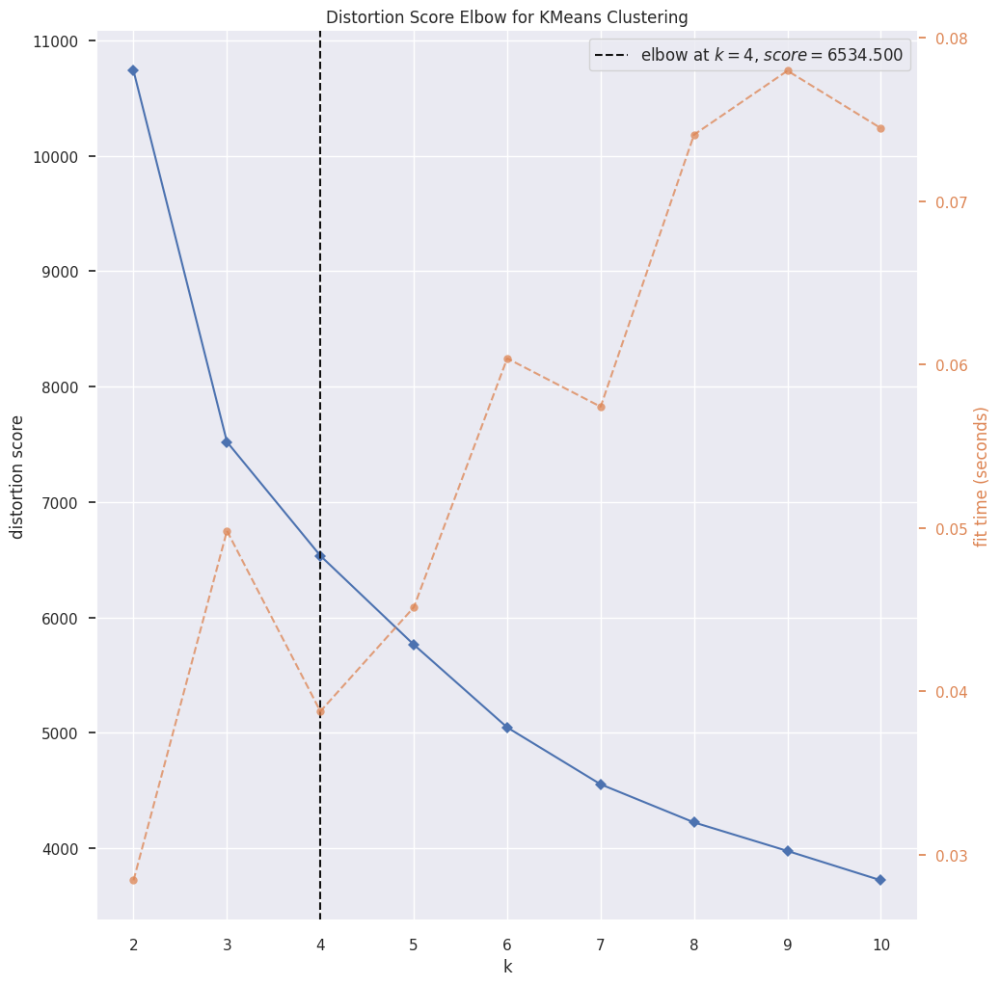

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [ ]:

model = KMeans()
visualizer = KElbowVisualizer(model, k=10)
visualizer.fit(PCA_ds)
visualizer.show()

In [ ]:
## Chọn cụm k = 4 để phân khúc khách hàng

In [ ]:
# Gán mô hình phân cụm
KM = KMeans(n_clusters=4)
# Fit model và dự đoán mô hình phân cụm
KM_ds = KM.fit_predict(PCA_ds)
# Add dự đoán vào datafame
df["Clusters"]= KM.labels_

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [ ]:
df['Clusters'].value_counts()

0    945
2    484
1    430
3    346
Name: Clusters, dtype: int64

In [ ]:
df.head()

,Education,Income,Recency,Wines,Fruits,Meat,Fish,Sweets,Gold,NumDealsPurchases,...,Complain,Response,Customer_For,Age,Spent,Living_With,Children,NumTotalPurchases,TotalAcceptedCmp,Clusters
0,0,58138.0,58,635,88,546,172,88,88,3,...,0,1,83894400000000000,66,1617,0,0,22,0,2
1,0,46344.0,38,11,1,6,2,1,6,2,...,0,0,10800000000000000,69,27,0,2,4,0,0
2,0,71613.0,26,426,49,127,111,21,42,1,...,0,0,40780800000000000,58,776,1,0,20,0,1
3,0,26646.0,26,11,4,20,10,3,5,2,...,0,0,5616000000000000,39,53,1,1,6,0,0
4,1,58293.0,94,173,43,118,46,27,15,5,...,0,0,27734400000000000,42,422,1,1,14,0,3


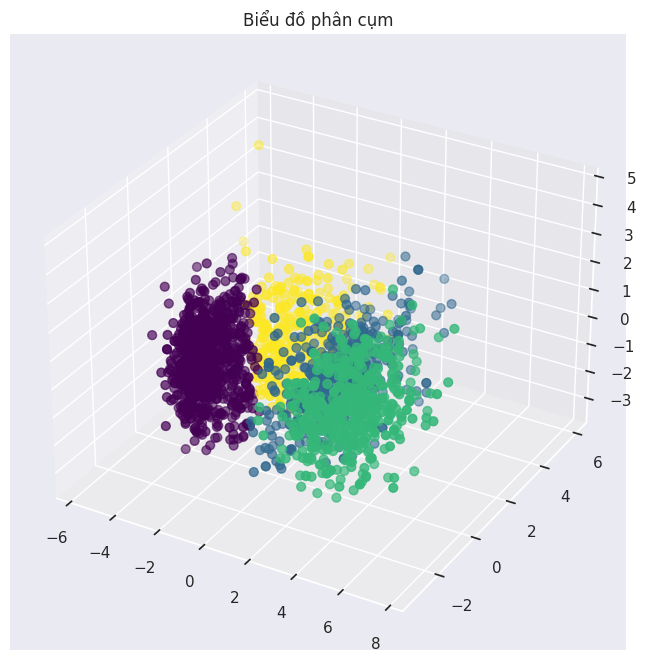

In [ ]:
# Vẽ biểu đồ :
fig = plt.figure(figsize=(10,8))
ax = plt.subplot(111, projection='3d', label="bla")
ax.scatter(x, y, z, s=40, c=df["Clusters"], marker='o', cmap = 'viridis' )
ax.set_title("Biểu đồ phân cụm")
plt.show()

#**Phân tích - đánh giá Segment**

## **Xét tỉ lệ phân khúc**

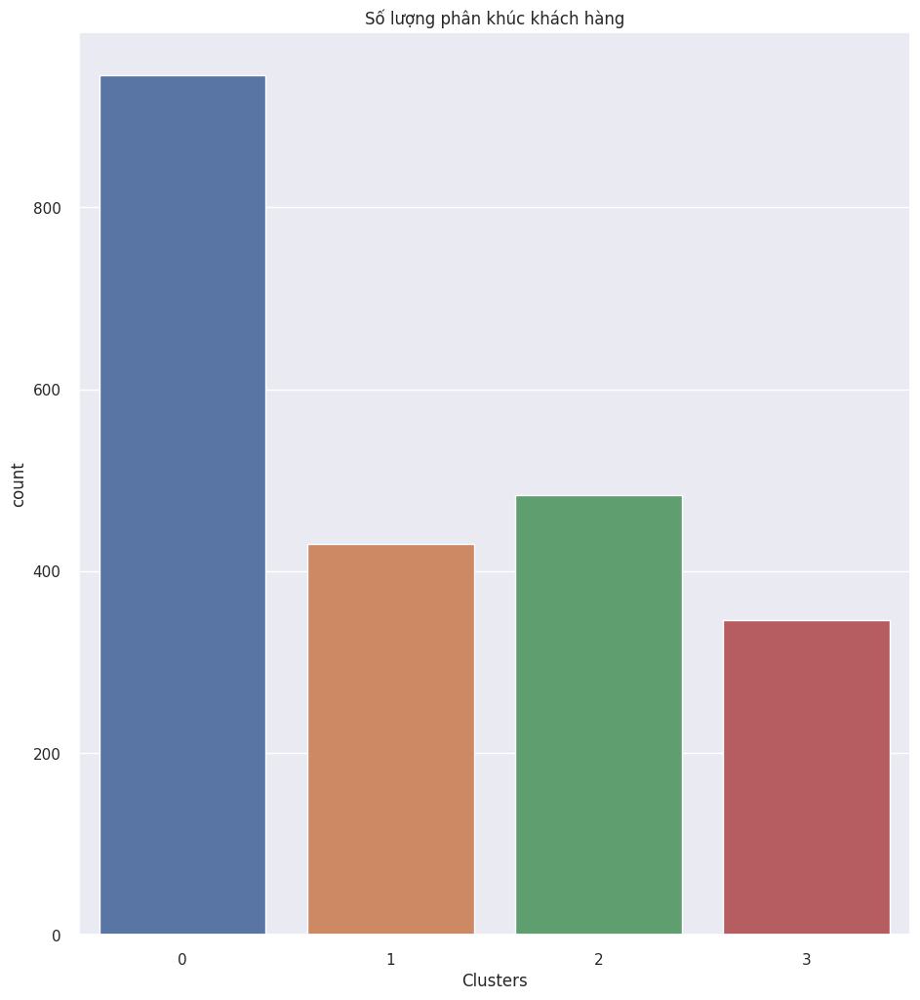

In [ ]:
pl = sns.countplot(x=df["Clusters"])
pl.set_title("Số lượng phân khúc khách hàng")
plt.show()

Text(0.5, 1.0, '% Clusters')

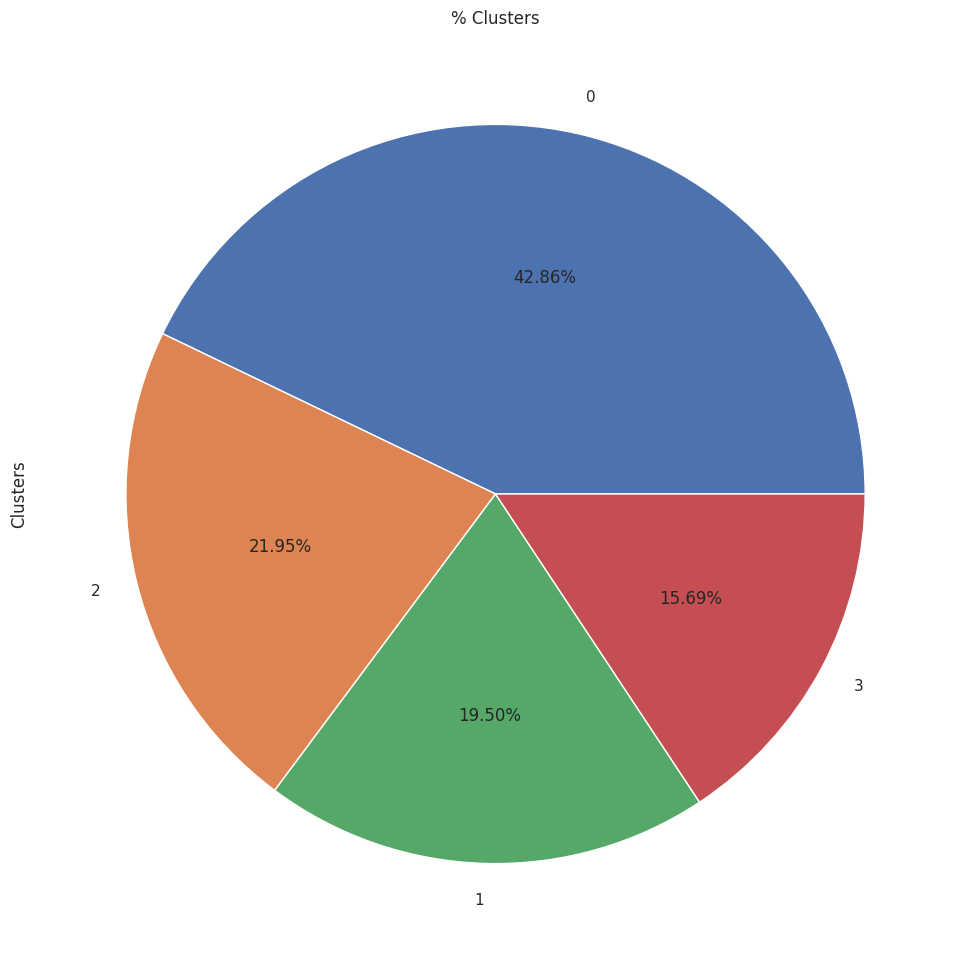

In [ ]:
ax = df['Clusters'].value_counts().plot(kind = 'pie',figsize=(12,12),autopct='%1.2f%%')
ax.set_title('% Clusters', fontsize = 12)

## **Phân tích đặc tính khách hàng theo từng Clusters**

### Phân khúc theo thu nhập income + spent

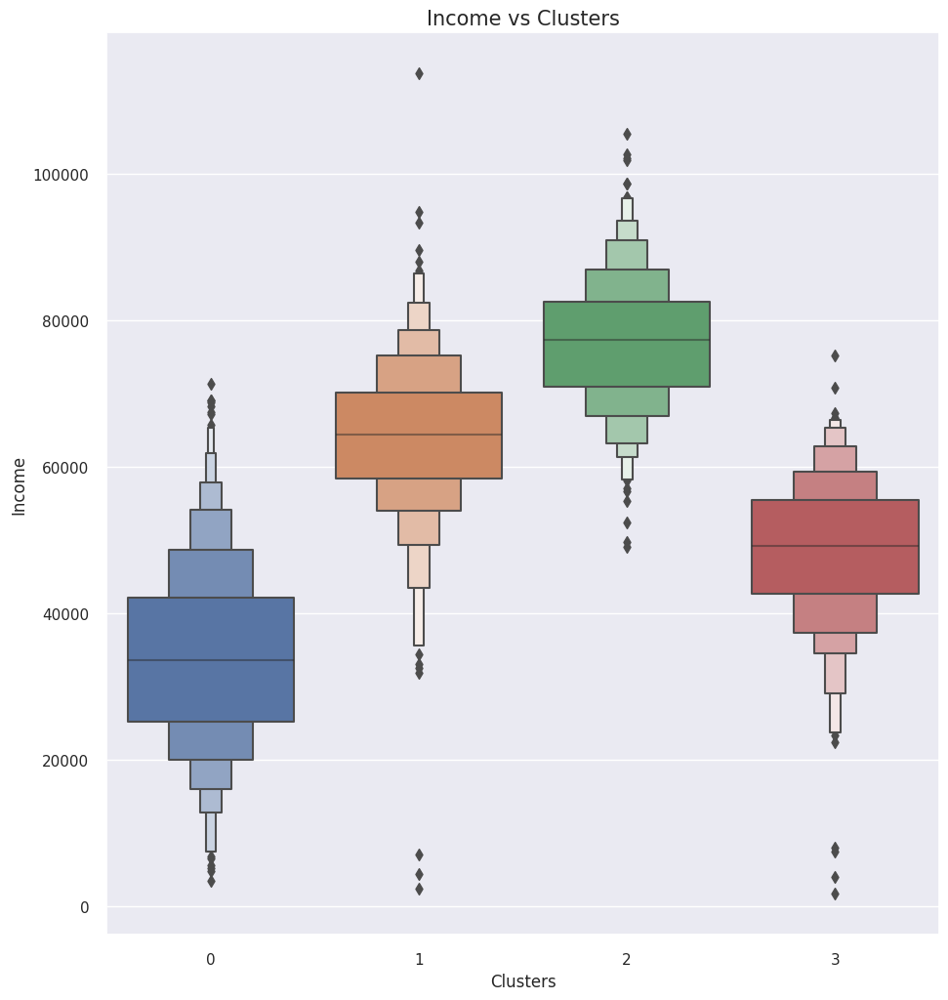

In [ ]:
sns.boxenplot(x=df["Clusters"], y=df["Income"])
plt.title("Income vs Clusters", size=15)
plt.show()

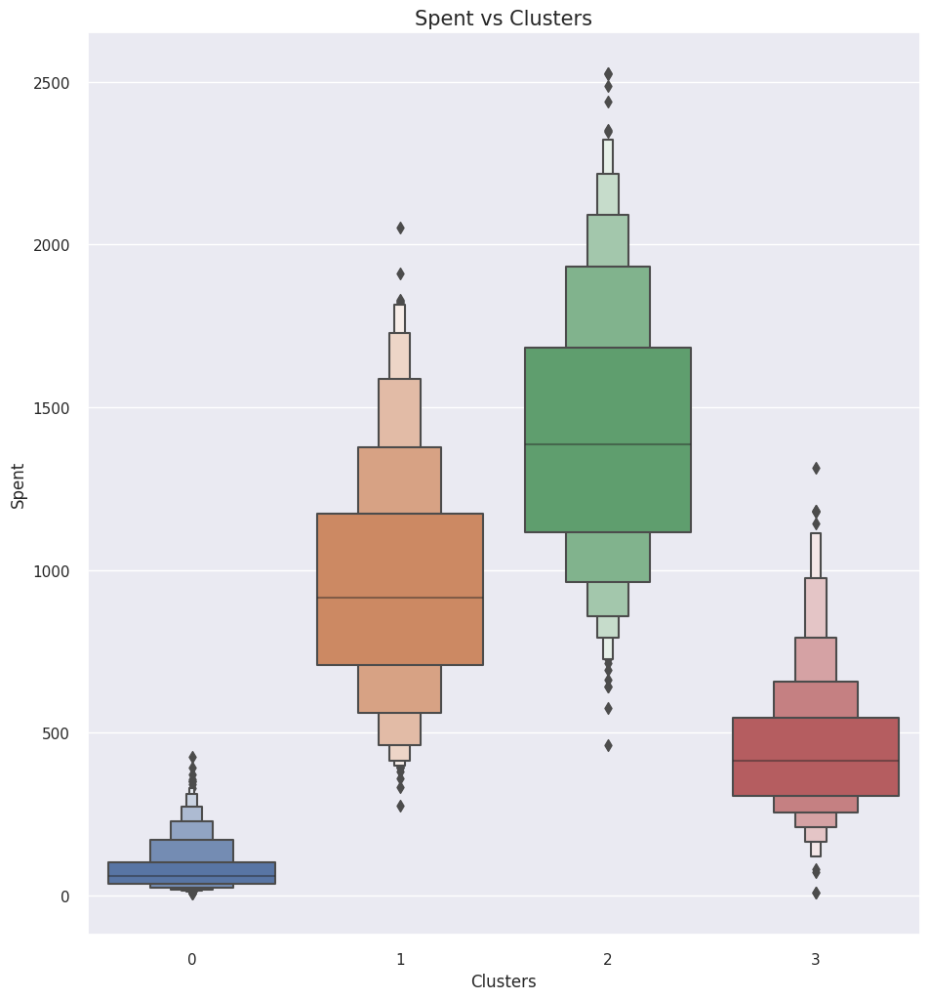

In [ ]:
sns.boxenplot(x=df["Clusters"], y=df["Spent"])
plt.title("Spent vs Clusters", size=15)
plt.show()

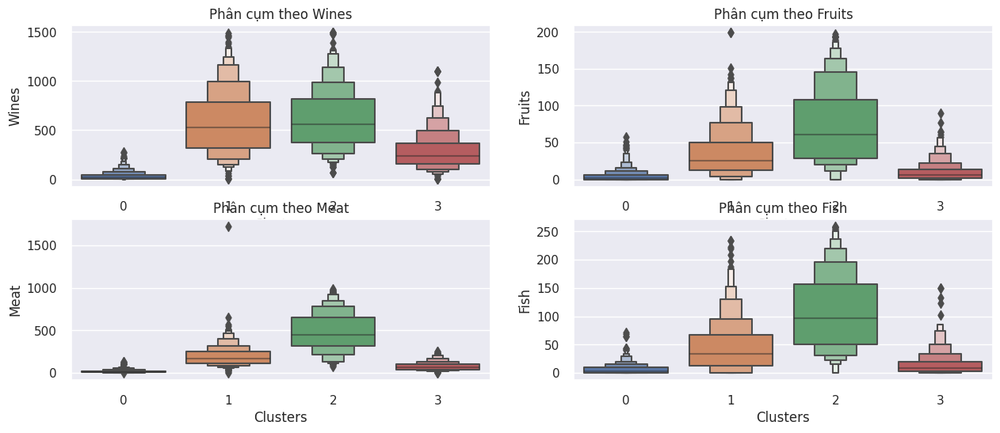

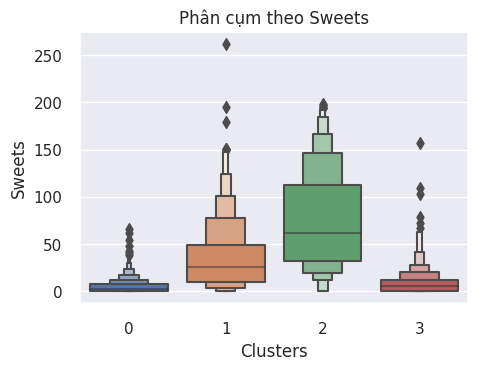

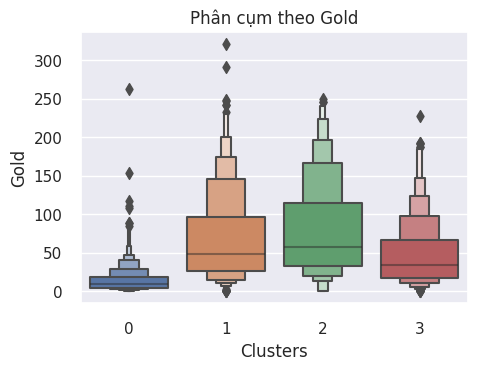

In [ ]:
fig = plt.figure(figsize = ([15, 9]))
plt.subplot(3, 2, 1)
sns.boxenplot(x=df["Clusters"], y=df["Wines"])
plt.title('Phân cụm theo Wines')
plt.subplot(3, 2, 2)
sns.boxenplot(x=df["Clusters"], y=df["Fruits"])
plt.title('Phân cụm theo Fruits')
plt.subplot(3, 2, 3)
sns.boxenplot(x=df["Clusters"], y=df["Meat"])
plt.title('Phân cụm theo Meat')
plt.subplot(3, 2, 4)
sns.boxenplot(x=df["Clusters"], y=df["Fish"])
plt.title('Phân cụm theo Fish')
plt.show()
plt.subplot(3, 2, 5)
sns.boxenplot(x=df["Clusters"], y=df["Sweets"])
plt.title('Phân cụm theo Sweets')
plt.show()
plt.subplot(3, 2, 6)
sns.boxenplot(x=df["Clusters"], y=df["Gold"])
plt.title('Phân cụm theo Gold')
plt.show()

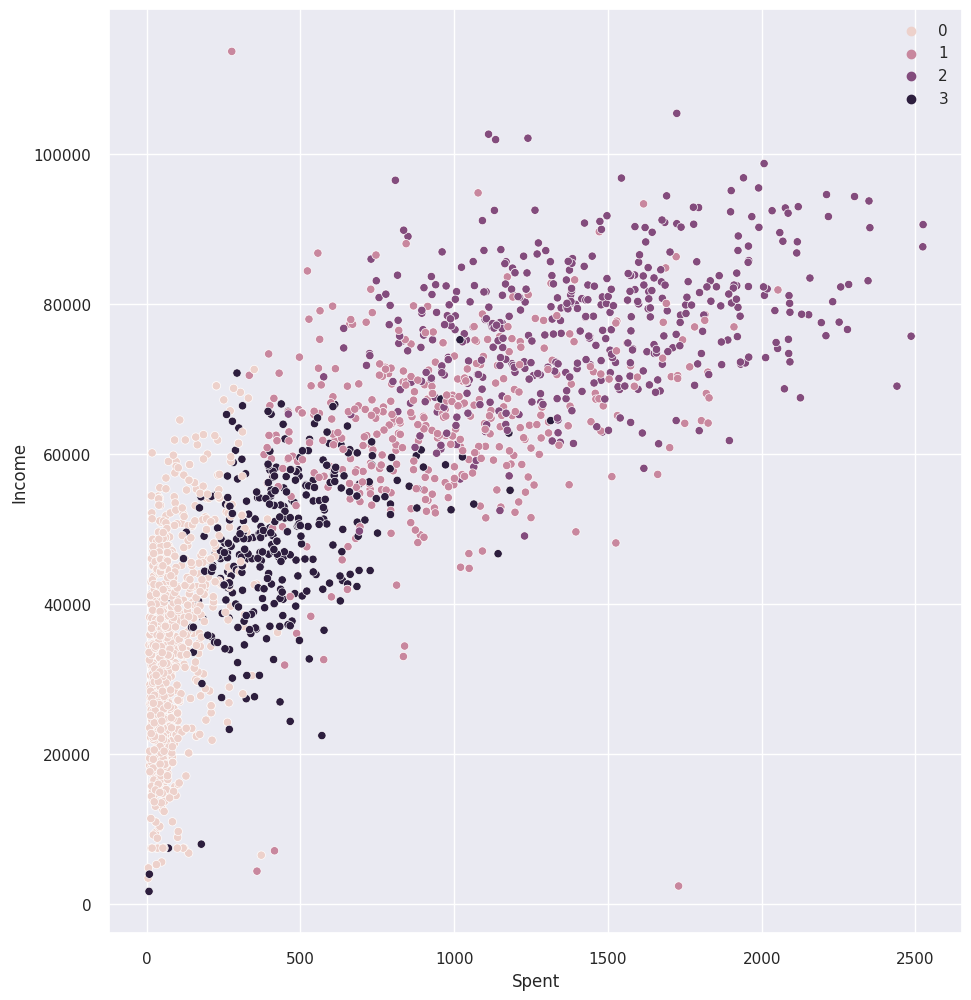

In [ ]:
pl = sns.scatterplot(data = df,x=df["Spent"], y=df["Income"],hue=df["Clusters"])
plt.legend()
plt.show()

###Phân khúc khách hàng theo độ tuổi

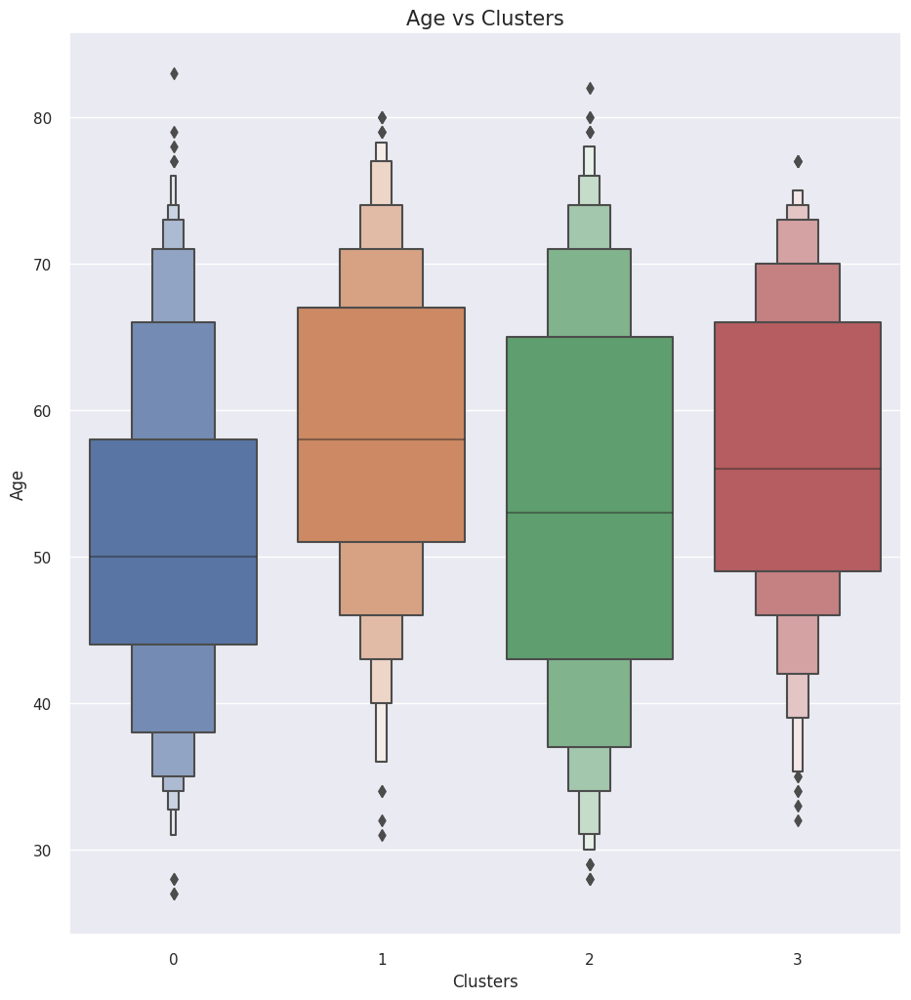

In [ ]:
sns.boxenplot(x=df["Clusters"], y=df["Age"])
plt.title("Age vs Clusters", size=15)
plt.show()

###Phân khúc khách hàng theo trình độ học vấn - Education

In [ ]:
cluster_0 = df.loc[df['Clusters'] == 0]
cluster_1 = df.loc[df['Clusters'] == 1]
cluster_2 = df.loc[df['Clusters'] == 2]
cluster_3 = df.loc[df['Clusters'] == 3]

In [ ]:
df['Education'].value_counts()

0    1113
1    1038
2      54
Name: Education, dtype: int64

In [ ]:
# Chú thích: Education: 0 = Graduate ; 1 = Postgraduate ; 2 = Undergradute

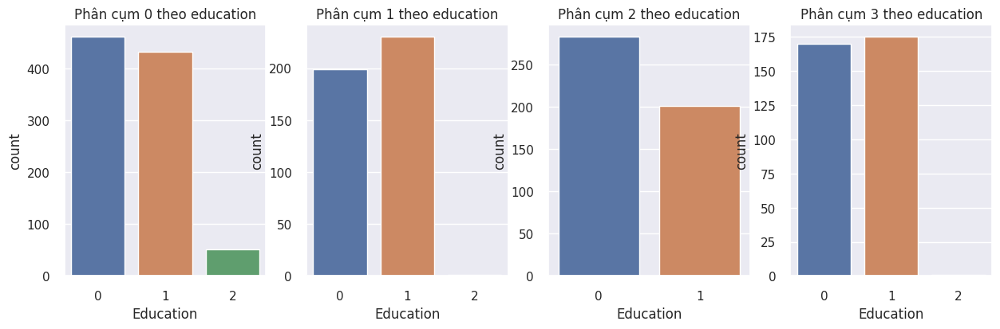

In [ ]:
fig = plt.figure(figsize = ([15, 9]))
plt.subplot(2, 4, 1)
sns.countplot(data = cluster_0, x = 'Education')
plt.title('Phân cụm 0 theo education')
plt.subplot(2, 4, 2)
sns.countplot(data = cluster_1, x = 'Education')
plt.title('Phân cụm 1 theo education')
plt.subplot(2, 4, 3)
sns.countplot(data = cluster_2, x = 'Education')
plt.title('Phân cụm 2 theo education')
plt.subplot(2, 4, 4)
sns.countplot(data = cluster_3, x = 'Education')
plt.title('Phân cụm 3 theo education')
plt.show()

### **Phân theo Living_With**

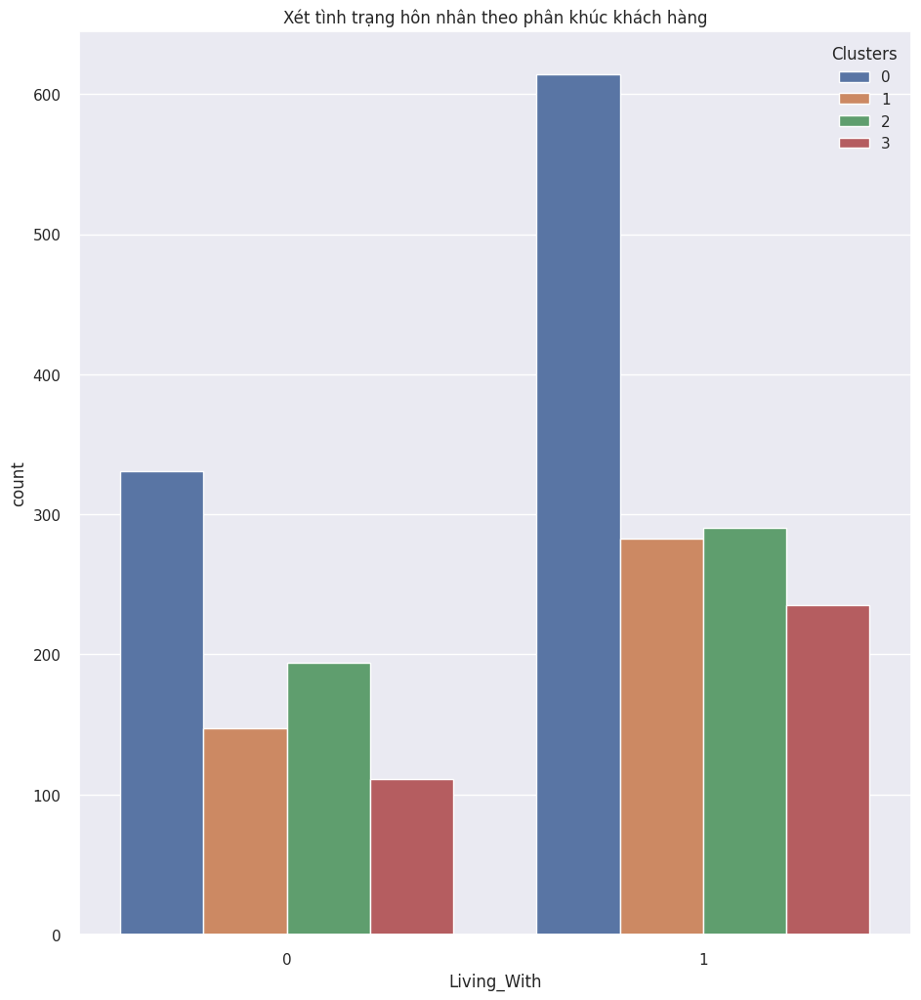

In [ ]:
plt.figure()
pl = sns.countplot(x=df["Living_With"],hue=df["Clusters"])
pl.set_title("Xét tình trạng hôn nhân theo phân khúc khách hàng")
plt.show()

### **Phân theo Children**

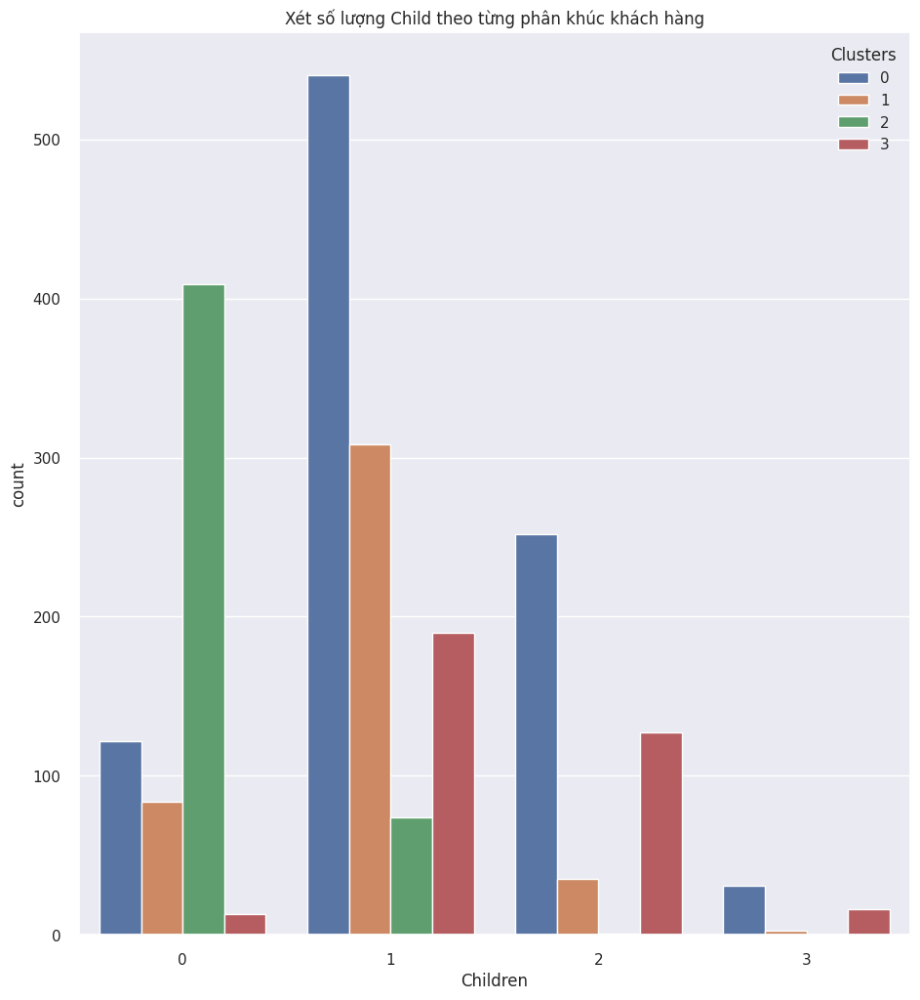

In [ ]:
plt.figure()
pl = sns.countplot(x=df["Children"],hue=df["Clusters"])
pl.set_title("Xét số lượng Child theo từng phân khúc khách hàng")
plt.show()

### **Phân theo chương trình khuyến mãi**

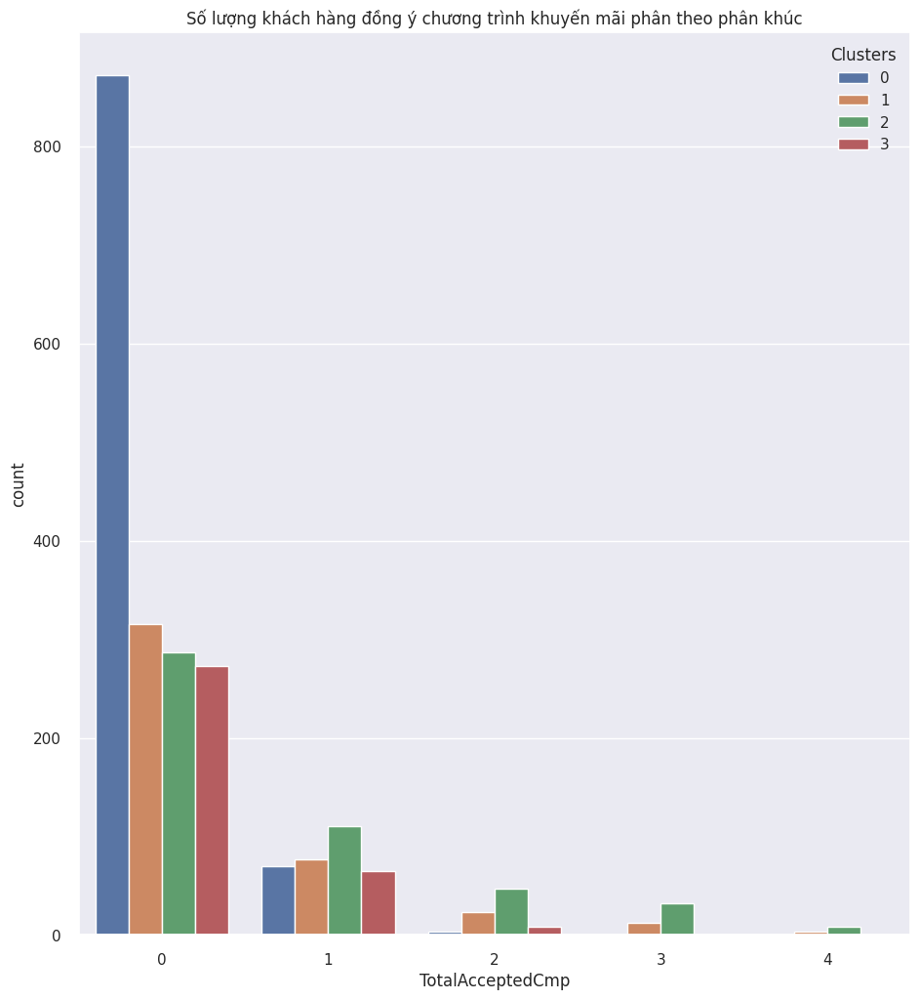

In [ ]:
plt.figure()
pl = sns.countplot(x=df["TotalAcceptedCmp"],hue=df["Clusters"])
pl.set_title("Số lượng khách hàng đồng ý chương trình khuyến mãi phân theo phân khúc")
plt.show()

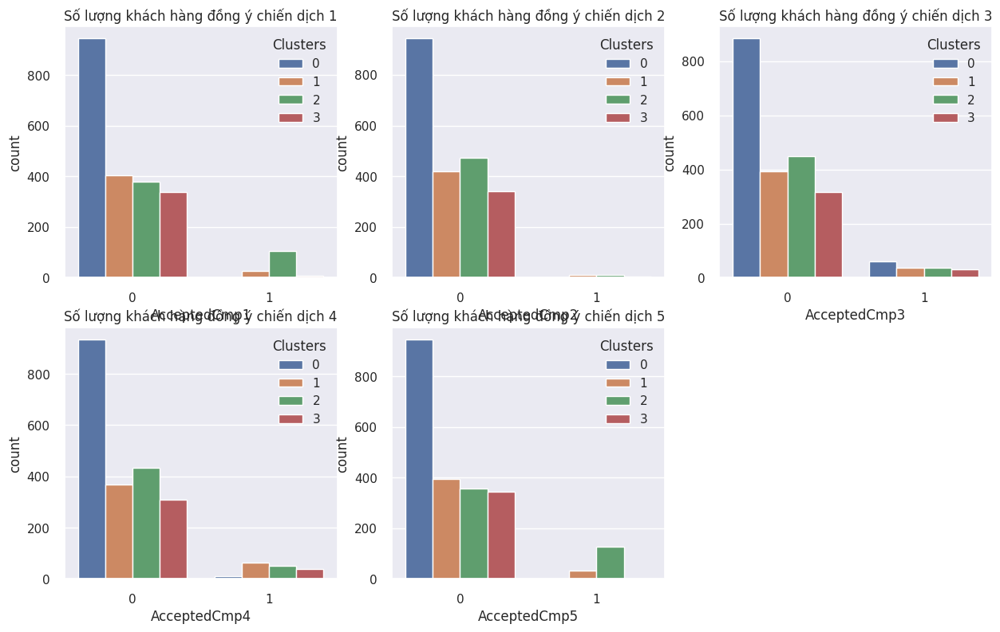

In [ ]:
fig = plt.figure(figsize = ([15, 9]))
plt.subplot(2, 3, 1)
pl = sns.countplot(x=df["AcceptedCmp1"],hue=df["Clusters"])
pl.set_title("Số lượng khách hàng đồng ý chiến dịch 1")
plt.subplot(2, 3, 2)
pl = sns.countplot(x=df["AcceptedCmp2"],hue=df["Clusters"])
pl.set_title("Số lượng khách hàng đồng ý chiến dịch 2")
plt.subplot(2, 3, 3)
pl = sns.countplot(x=df["AcceptedCmp3"],hue=df["Clusters"])
pl.set_title("Số lượng khách hàng đồng ý chiến dịch 3")
plt.subplot(2, 3, 4)
pl = sns.countplot(x=df["AcceptedCmp4"],hue=df["Clusters"])
pl.set_title("Số lượng khách hàng đồng ý chiến dịch 4")
plt.subplot(2, 3, 5)
pl = sns.countplot(x=df["AcceptedCmp5"],hue=df["Clusters"])
pl.set_title("Số lượng khách hàng đồng ý chiến dịch 5")
plt.show()

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2205 entries, 0 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Education            2205 non-null   int64  
 1   Income               2205 non-null   float64
 2   Recency              2205 non-null   int64  
 3   Wines                2205 non-null   int64  
 4   Fruits               2205 non-null   int64  
 5   Meat                 2205 non-null   int64  
 6   Fish                 2205 non-null   int64  
 7   Sweets               2205 non-null   int64  
 8   Gold                 2205 non-null   int64  
 9   NumDealsPurchases    2205 non-null   int64  
 10  NumWebPurchases      2205 non-null   int64  
 11  NumCatalogPurchases  2205 non-null   int64  
 12  NumStorePurchases    2205 non-null   int64  
 13  NumWebVisitsMonth    2205 non-null   int64  
 14  AcceptedCmp3         2205 non-null   int64  
 15  AcceptedCmp4         2205 non-null   i

###**Phân theo mua hàng với voucher**

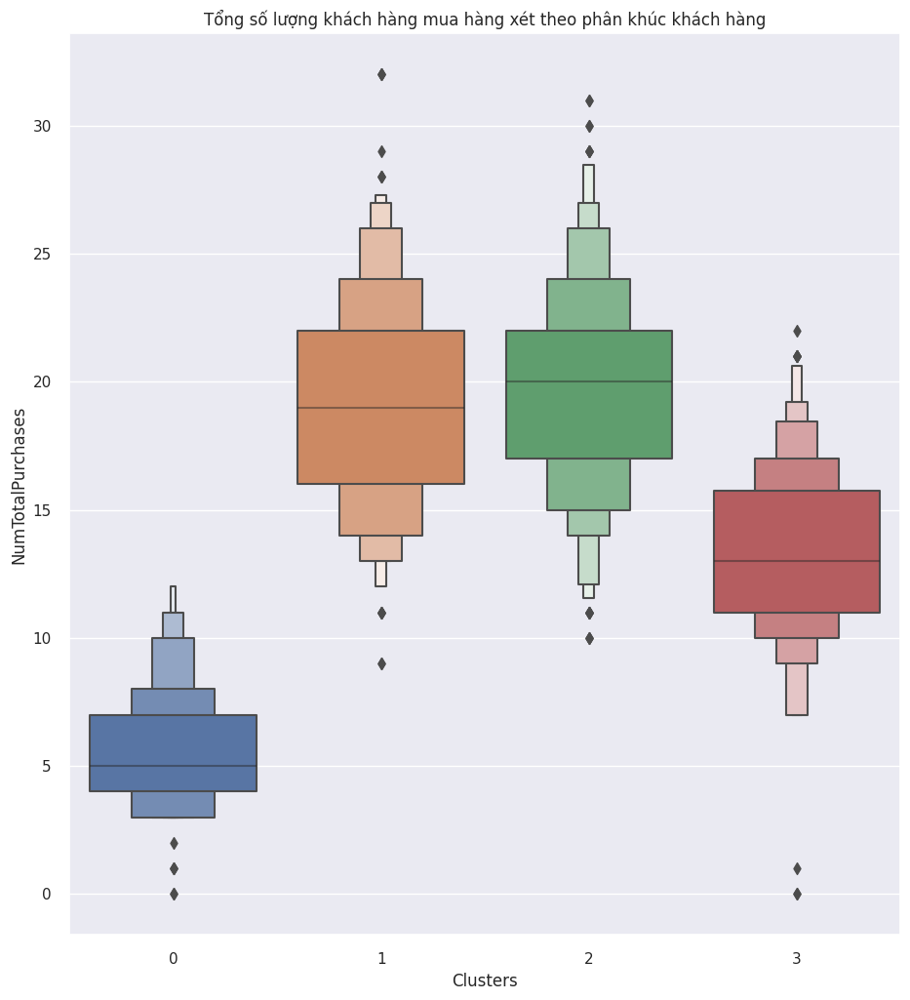

In [ ]:
plt.figure()
pl=sns.boxenplot(y=df["NumTotalPurchases"],x=df["Clusters"])
pl.set_title("Tổng số lượng khách hàng mua hàng xét theo phân khúc khách hàng")
plt.show()

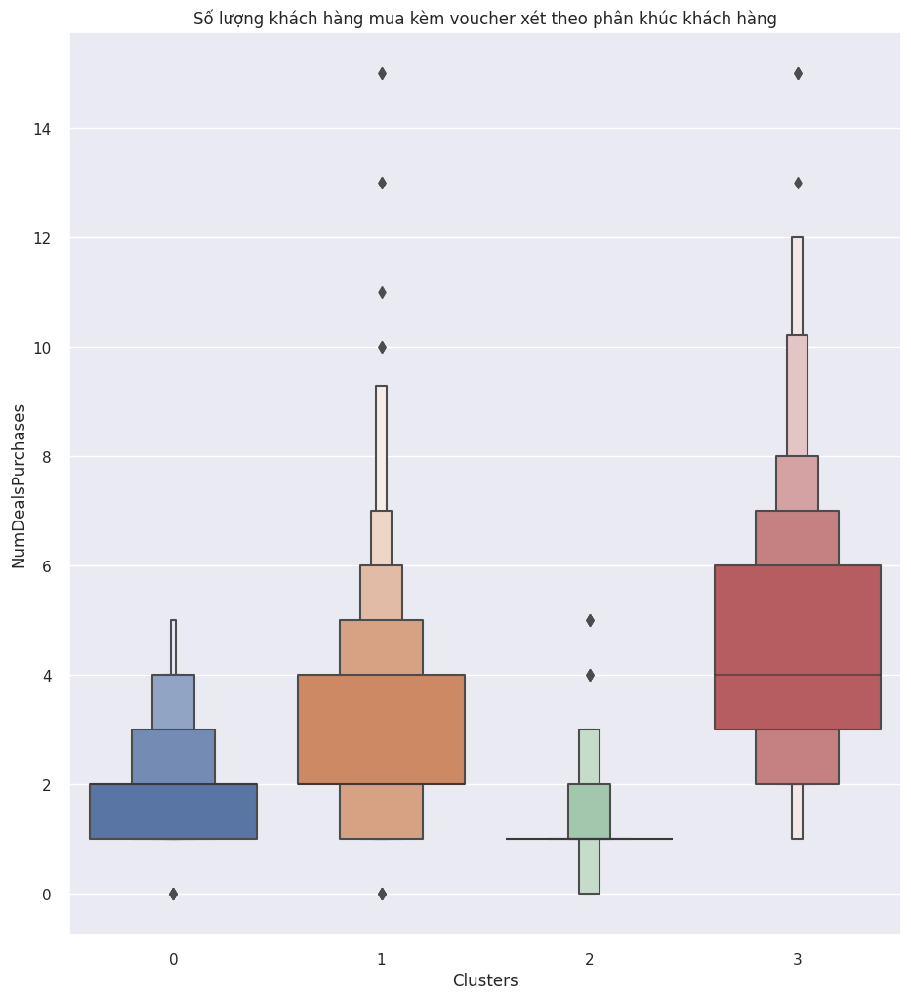

In [ ]:
plt.figure()
pl=sns.boxenplot(y=df["NumDealsPurchases"],x=df["Clusters"])
pl.set_title("Số lượng khách hàng mua kèm voucher xét theo phân khúc khách hàng")
plt.show()

### **Phân theo cụm nào mua cuối cùng**

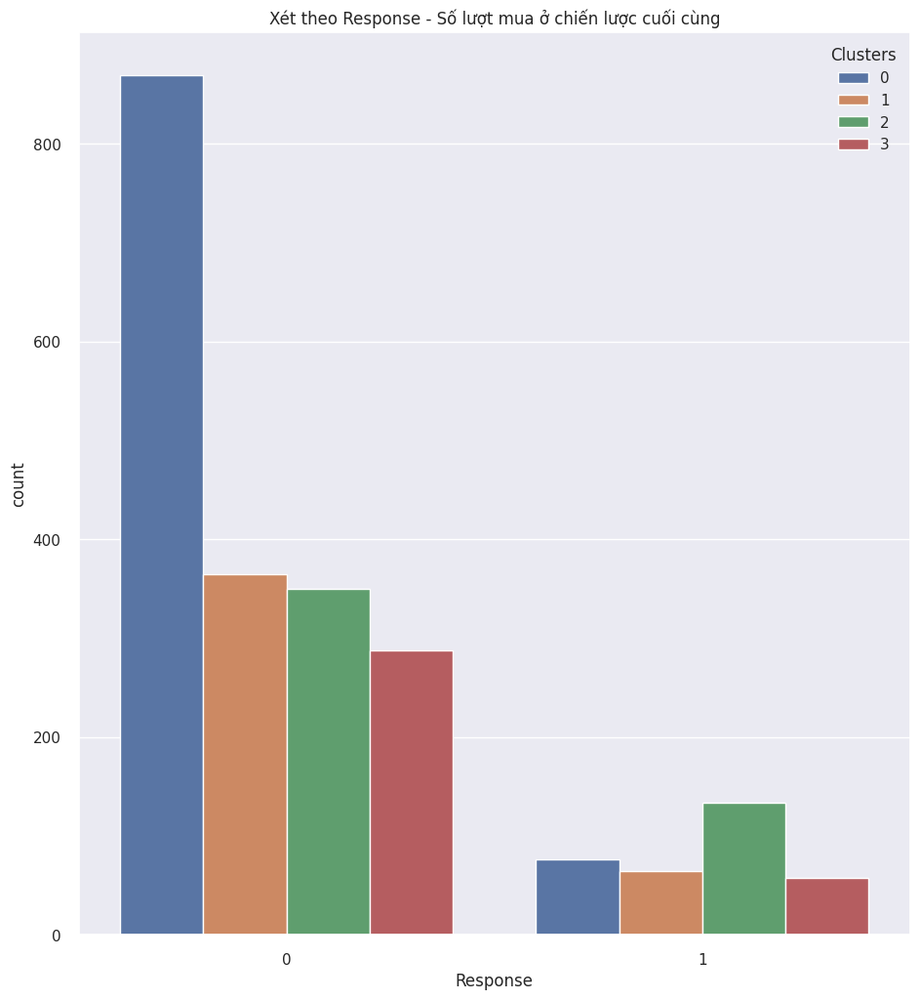

In [ ]:
plt.figure()
pl = sns.countplot(x=df["Response"],hue=df["Clusters"])
pl.set_title("Xét theo Response - Số lượt mua ở chiến lược cuối cùng")
plt.show()